In this notebook i will attempt to perfrom analysis of the source of inspiration for each group. I will perfrom the mannwhitneyu U-test to determine wheter the distribution of top 3 inspirations for each metric seems to be staticially significantly different. I will also attempt to see wheter Wilcoxon signed test will provide results that seems to have sense

## Imports and loader functions

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

import cv2
import numpy as np
import PIL
import os
import re

In [4]:

def imshow(img):
    img = img.astype(np.uint8)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    display(PIL.Image.fromarray(img).convert("RGB"))


def imshow_on_axis(img, ax, title):
    img = img.astype(np.uint8)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img)
    ax.set_title(title)
    ax.axis("off")


def imshow_paired(img1, img2, ax, label1="Image 1", label2="Image 2", target_size=300):
    
    img1 = img1.astype(np.uint8)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    
    img2 = img2.astype(np.uint8)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

    img1_resized = resize_image_to_square(img1, target_size)
    img2_resized = resize_image_to_square(img2, target_size)

    ax.axis("off")

    ax.imshow(np.hstack([img1_resized, img2_resized]))

    height, width = img1_resized.shape[:2]
    ax.text(
        width / 2, -10, label1, ha="center", va="bottom", fontsize=12, color="black"
    )
    ax.text(
        width + (width / 2),
        -10,
        label2,
        ha="center",
        va="bottom",
        fontsize=12,
        color="black",
    )


def resize_image_to_square(img, target_size):
    height, width = img.shape[:2]

    if height > width:
        padding = (height - width) // 2
        img_resized = cv2.copyMakeBorder(
            img, 0, 0, padding, padding, cv2.BORDER_CONSTANT, value=(255, 255, 255)
        )
    elif width > height:
        padding = (width - height) // 2
        img_resized = cv2.copyMakeBorder(
            img, padding, padding, 0, 0, cv2.BORDER_CONSTANT, value=(255, 255, 255)
        )
    else:
        img_resized = img

    img_resized = cv2.resize(img_resized, (target_size, target_size))
    return img_resized


def load_images_from_path(path):
    images = []
    srcs = []
    
    for filename in os.listdir(path):
        img = cv2.imread(os.path.join(path, filename))
        if img is not None:
            images.append(img)
            srcs.append(filename)

    return images, srcs


def load_images(number):
    final_images = []
    final_srcs = []

    final_path = f"data/{number}/final"
    web_path = f"data/{number}/web"
    ai_path = f"data/{number}/ai"

    if not os.path.exists(final_path):
        print(f"The final submissions path '{final_path}' does not exist.")
        return None, None, None

    for filename in os.listdir(final_path):
        img = cv2.imread(os.path.join(final_path, filename))
        if img is not None:
            final_images.append(img)
            final_srcs.append(f"{number}_{filename}")
            
            
    web_images, web_srcs = load_images_from_path(web_path)
    ai_images, ai_srcs = load_images_from_path(ai_path)

    if not final_images:
        print(f"No images found in '{final_path}'. Please check the contents.")
        return None, None, None

    if not web_images and not ai_images:
        print(
            f"The number '{number}' does not correspond to any valid images in 'web' or 'ai' folders."
        )
        return None, None, None

    if not web_images:
        print(f"No web images found with prefix '{number}' in '{web_path}'.")
        return None, None, None
    if not ai_images:
        print(f"No AI images found with prefix '{number}' in '{ai_path}'.")
        return None, None, None

    return final_images, web_images, ai_images, final_srcs, web_srcs, ai_srcs

In [5]:
def read_csv(path):
    try:
        df = pd.read_csv(path)
        return df
    except Exception as e:
        print(f"Error reading the file: {e}")
        return None

In [6]:
metrics = ['Color_Similarity', 'ResNet_Similarity', 'Dino_Similarity', 'Contrast_Similarity']

In [7]:
combined_df = read_csv("csv/all_similarities_with_srcs.csv")
combined_df.head()

,Final_Submission,Inspiration,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity,Source
0,1_1.png,1A_1.jpg,0.529821,0.797856,0.823561,0.744530,Web
1,1_1.png,1A_10.jpg,0.858951,0.604741,0.716302,0.624540,Web
2,1_1.png,1A_2.jpg,0.751328,0.615733,0.370060,0.883636,Web
3,1_1.png,1A_3.jpg,0.720056,0.551096,0.477145,0.869095,Web
4,1_1.png,1A_4.jpg,0.769988,0.652863,0.437572,0.813474,Web


In [8]:
mean_color = combined_df["Color_Similarity"].mean()
mean_resnet = combined_df["ResNet_Similarity"].mean()
mean_dino = combined_df["Dino_Similarity"].mean()
mean_contrast = combined_df["Contrast_Similarity"].mean()
print(f"Mean color similarity: {mean_color}")
print(f"Mean ResNet similarity: {mean_resnet}")
print(f"Mean Dino similarity: {mean_dino}")
print(f"Mean contrast similarity: {mean_contrast}")

Mean color similarity: 0.7228696771155503
Mean ResNet similarity: 0.6168207390423981
Mean Dino similarity: 0.4881615814456812
Mean contrast similarity: 0.7690218041397553


## Code for group analysis

In [9]:
import scipy.stats as stats
from scipy.stats import norm

def perform_mannwhitneyu_test(data, p=0.05, label = "Conclusion_U_test"):
    #Test to define wheter distributions of the two groups are equal or not
    #If not equal we assume that the one with higher median is better
    results = {label: {}}
    
    for metric in metrics:
        scores_method_1 = data[data['Metric'] == metric].query("Source == 'AI'")['Similarity']
        scores_method_2 = data[data['Metric'] == metric].query("Source == 'Web'")['Similarity']

        statistic, p_value = stats.mannwhitneyu(scores_method_1, scores_method_2, alternative='two-sided')

        if p_value < p:
            if scores_method_1.median() > scores_method_2.median():
                results[label][metric] = "AI"
            else:
                results[label][metric] = "Web"
        else:
            results[label][metric] = "none"
        
    return pd.DataFrame(results).transpose()


In [10]:
from statsmodels.stats.weightstats import ztest as ztest

def perform_z_test(data, p=0.05):
    # Test to define wheter the mean of two groups are equal or not
    # If not equal we assume that the one with higher mean is better
    results = {"Conclusion_Z_test": {}}
    for metric in metrics:
        scores_method_1 = data[data['Metric'] == metric].query("Source == 'AI'")['Similarity']
        scores_method_2 = data[data['Metric'] == metric].query("Source == 'Web'")['Similarity']

        if len(scores_method_1) <= 30 or len(scores_method_2) <= 30:
            results["Conclusion_Z_test"][metric] = "too few samples"

        statistic, p_value = ztest(scores_method_1, scores_method_2, value = 0, usevar='unequal')

        if p_value < p:
            if scores_method_1.mean() > scores_method_2.mean():
                results["Conclusion_Z_test"][metric] = "AI"

            else:
                results["Conclusion_Z_test"][metric] = "Web"
        else:
            results["Conclusion_Z_test"][metric] = "none"
        
    return pd.DataFrame(results).transpose()
    

In [11]:
def perform_t_test(data, p=0.05):
    #Test to define wheter the mean of two groups are equal or not
    results = {"Conclusion_T_test": {}}
    for metric in metrics:
        scores_method_1 = data[data['Metric'] == metric].query("Source == 'AI'")['Similarity']
        scores_method_2 = data[data['Metric'] == metric].query("Source == 'Web'")['Similarity']
        
        statistic, p_value = stats.ttest_ind(scores_method_1, scores_method_2, equal_var=False)
            
        if p_value < p:
            if scores_method_1.mean() > scores_method_2.mean():
                results["Conclusion_T_test"][metric] = "AI"
            else:
                results["Conclusion_T_test"][metric] = "Web"
        else:
            results["Conclusion_T_test"][metric] = "none"
            
    return pd.DataFrame(results).transpose()

In [12]:
from scipy.stats import wilcoxon

def perform_wilcoxon_analysis(data, p=0.05):
    results = {"Conclusion_Wilcoxon": {}}

    for metric in metrics:
        ai_top_scores = []
        web_top_scores = []

        for submission in data.Final_Submission.unique():
            ai_top_scores.append(
                data[
                    (data.Final_Submission == submission)
                    & (data.Source == "AI")
                    & (data.Metric == metric)
                ]["Similarity"].max()
            )
            web_top_scores.append(
                data[
                    (data.Final_Submission == submission)
                    & (data.Source == "Web")
                    & (data.Metric == metric)
                ]["Similarity"].max()
            )

        stat, p_value = wilcoxon(web_top_scores, ai_top_scores)

        web_median = np.median(web_top_scores)
        ai_median = np.median(ai_top_scores)

        if p_value < p:
            if web_median > ai_median:
                conclusion = "Web"
            else:
                conclusion = "AI"
        else:
            conclusion = None


        results["Conclusion_Wilcoxon"][metric] = conclusion

    transposed_results = pd.DataFrame(results).transpose()

    return transposed_results
        

In [13]:

def perfrom_mean_diff_test(data, alpha=0.02, label="Conclusion_Custom"):
    #In this test we basiclaly analyze the mean difference betewene top similarities
    #If one method has higher mean similarity we assume it is better
    
    results = {label: {}}
    
    for metric in metrics:
        ai_top_scores = []
        web_top_scores = []
        
        for submission in data.Final_Submission.unique():
            ai_top_scores.append(
                data[
                    (data.Final_Submission == submission)
                    & (data.Source == "AI")
                    & (data.Metric == metric)
                ]["Similarity"].max()
            )
            web_top_scores.append(
                data[
                    (data.Final_Submission == submission)
                    & (data.Source == "Web")
                    & (data.Metric == metric)
                ]["Similarity"].max()
            )
        
        diffs = [web_top_scores[i] - ai_top_scores[i] for i in range(len(ai_top_scores))]
        sum_diffs = sum(diffs)
        avg_diff = sum_diffs / len(diffs)
        
        if avg_diff > alpha:
            results[label][metric] = "Web"
        elif avg_diff < -alpha:
            results[label][metric] = "AI"
        else:
            results[label][metric] = "none"
        
    return pd.DataFrame(results).transpose()
    

In [14]:
def perfrom_weighted_voting(data, alpha=0.05, label="weighted_voting"):
    # We look for significant inspirations i.e. the top inspirations from web and AI that are significantly different
    # If the difference is not significant we checkl the difference bewteen top 2 similarities, top 3 etc until we find a significant difference
    # Teh we add to voting pool avg of top inspirations that were needed to determine significant difference
    # Then perfrom weighted voting to decide whcih methos is better having weights= similarity scores
    # Awlays returns a decision but with varying strength
    # I like to think of strength > 1.5 * mean_similarity of a metric as a strong decision
    # It basically means that the on average 1.5 more final submission were inspired by a given source than the other

    results = {f"Decision of {label}": {}, f"Strength of {label}": {}}

    for metric in metrics:
        ai_voting_pool = []
        web_voting_pool = []

        for submission in data.Final_Submission.unique():
            ai_similarities = (
            data[(data.Final_Submission == submission) & (data.Source == "AI") & (data.Metric == metric)]
            .sort_values(by="Similarity", ascending=False)["Similarity"]
            .tolist()
            )

            web_similarities = (
                data[(data.Final_Submission == submission) & (data.Source == "Web") & (data.Metric == metric)]
                .sort_values(by="Similarity", ascending=False)["Similarity"]
                .tolist()
            )

            i = 0
            significant_found = False

            while i < min(len(ai_similarities), len(web_similarities)):
                ai_top = ai_similarities[i]
                web_top = web_similarities[i]
                diff = web_top - ai_top

                if diff > alpha:
                    web_voting_pool.append(sum(web_similarities[: i + 1]) / (i + 1))
                    significant_found = True
                    break
                elif diff < -alpha:
                    ai_voting_pool.append(sum(ai_similarities[: i + 1]) / (i + 1))
                    significant_found = True
                    break

                i += 1

            if not significant_found:
                avg_web = sum(web_similarities[:i]) / i if i > 0 else 0
                avg_ai = sum(ai_similarities[:i]) / i if i > 0 else 0
                web_voting_pool.append(avg_web)
                ai_voting_pool.append(avg_ai)

        ai_weight = sum(ai_voting_pool)
        web_weight = sum(web_voting_pool)
        strength = abs(ai_weight - web_weight)

        if ai_weight > web_weight:
            if strength > 1.5 * combined_df[metric].mean():
                results[f"Decision of {label}"][metric] = "Strongly AI"
                results[f"Strength of {label}"][metric] = strength
            else:
                results[f"Decision of {label}"][metric] = "Weakly AI"
                results[f"Strength of {label}"][metric] = strength

        elif web_weight > ai_weight:
            if strength > 1.5 * combined_df[metric].mean():
                results[f"Decision of {label}"][metric] = "Strongly Web"
                results[f"Strength of {label}"][metric] = strength
            else:
                results[f"Decision of {label}"][metric] = "Weakly Web"
                results[f"Strength of {label}"][metric] = strength

    return pd.DataFrame(results).transpose()

In [15]:
def show_simmilarity(group_id, top_count=5, top_count_2 = None):
    filtered_df = combined_df[
        combined_df["Final_Submission"].str.startswith(f"{group_id}_")
    ]

    combined_df_melted = pd.melt(
        filtered_df,
        id_vars=["Final_Submission", "Source"],
        value_vars=metrics,
        var_name="Metric",
        value_name="Similarity",
    )

    combined_df_melted["Metric"] = pd.Categorical(
        combined_df_melted["Metric"], categories=metrics, ordered=True
    )
    
    top_similarities = (
        combined_df_melted.sort_values(
            ["Final_Submission", "Metric", "Source", "Similarity"],
            ascending=[True, True, False, False],
        )
        .groupby(["Final_Submission", "Metric", "Source"], observed=True)
        .head(top_count)
    )
    
    top_similarities_2 = (
        combined_df_melted.sort_values(
            ["Final_Submission", "Metric", "Source", "Similarity"],
            ascending=[True, True, False, False],
        )
        .groupby(["Final_Submission", "Metric", "Source"], observed=True)
        .head(top_count_2)
    )

    custom_palette = {"AI": "#1E74C3", "Web": "#D85C56"}
    strip_palette = {"AI": "#0F4A8E", "Web": "#9A1E1A"}

    plot_size = (15, 6) if top_count_2 is not None else (10, 6)
    
    fig, axes = plt.subplots(1, 2 if top_count_2 is not None else 1, figsize=plot_size, sharey=True)

    sns.violinplot(
        ax=axes[0] if top_count_2 is not None else axes,
        x="Metric",
        y="Similarity",
        hue="Source",
        data=top_similarities,
        inner=None,
        linewidth=1.5,
        split=True,
        palette=custom_palette,
        alpha=0.75,
        edgecolor="black",
    )

    sns.stripplot(
        ax=axes[0] if top_count_2 is not None else axes,
        x="Metric",
        y="Similarity",
        hue="Source",
        data=top_similarities,
        palette=strip_palette,
        jitter=True,
        alpha=0.8,
        size=5,
        dodge=True,
    )
    
    ax = axes[0] if top_count_2 is not None else axes

    ax.set_title(f"Top {top_count} most similar inspirations", fontsize=14)
    ax.set_xlabel("Metric", fontsize=12)
    ax.set_ylabel("Similarity", fontsize=12)
    
    

    if top_count_2 is not None:
        sns.violinplot(
            ax=axes[1],
            x="Metric",
            y="Similarity",
            hue="Source",
            data=top_similarities_2,
            inner=None,
            linewidth=1.5,
            split=True,
            palette=custom_palette,
            alpha=0.75,
            edgecolor="black",
        )

        sns.stripplot(
            ax=axes[1],
            x="Metric",
            y="Similarity",
            hue="Source",
            data=top_similarities_2,
            palette=strip_palette,
            jitter=True,
            alpha=0.8,
            size=5,
            dodge=True,
        )

        axes[1].set_title(f"Top {top_count_2} most similar inspirations", fontsize=14)
        axes[1].set_xlabel("Metric", fontsize=12)

    # General title for the plots
    fig.suptitle(f"GROUP: {group_id}", fontsize=18, fontweight="bold")
    plt.tight_layout()
    plt.show()

    return top_similarities, top_similarities_2

In [16]:
def get_top_inspirations(data, metric, top_n):
    top_two = data.sort_values(metric, ascending=False).head(top_n)
    
    top_two_values = top_two[[metric, "Inspiration", "Final_Submission", "Source"]]
    return top_two_values

def show_top_inspirations(group_id):
    final_images, web_images, ai_images, final_srcs, web_srcs, ai_srcs = load_images(group_id)
    
    
    filtered_df = combined_df[
        combined_df["Final_Submission"].str.startswith(f"{group_id}_")
    ]
    
    
    
    
    fig = plt.figure(figsize=(15, 10))
    gs = GridSpec(4, 2, figure=fig)
    
    for i, metric in enumerate(metrics):
        top_two = get_top_inspirations(filtered_df, metric, 2)
        top_1_sim, top_1_src, top_1_final, top_1_insp = top_two.iloc[0]
        top_2_sim, top_2_src, top_2_final, top_2_insp = top_two.iloc[1]
        
        top_1_image = ai_images[ai_srcs.index(top_1_src)] if top_1_insp == "AI" else web_images[web_srcs.index(top_1_src)]
        top_2_image = ai_images[ai_srcs.index(top_2_src)] if top_2_insp == "AI" else web_images[web_srcs.index(top_2_src)]
        
        ax = fig.add_subplot(gs[i, 0])
        imshow_paired(
            final_images[final_srcs.index(top_1_final)],
            top_1_image,
            ax,
            label1=f"Final Submission:\n {top_1_final}",
            label2=f"{top_1_insp}: {top_1_src} \n {metric}: {top_1_sim:.3f}"
        )
        
        ax = fig.add_subplot(gs[i, 1])
        imshow_paired(
            final_images[final_srcs.index(top_2_final)],
            top_2_image,
            ax,
            label1=f"Final Submission:\n {top_2_final}",
            label2=f"{top_2_insp}: {top_2_src} \n {metric}: {top_2_sim:.3f}"
        )
    
    fig.suptitle(f"Group {group_id}", fontsize=18, fontweight="bold", y=0.92)
    fig.text(0.5, 0.87, "Top 2 inspirations for each metric", ha='center', fontsize=12)
    
    plt.subplots_adjust(top=0.85)
    
    plt.tight_layout()
    plt.show()
        

In [17]:
def analyse_group(group_id, top_1 = 3, top_2 = 1, p = 0.05, alpha = 0.05):
   data_1, data_2 = show_simmilarity(group_id, top_1, top_2)
   u_results_1 = perform_mannwhitneyu_test(data_1, p, label = f"U-test top {top_1}")
   u_results_2 = perform_mannwhitneyu_test(data_2, p, label = f"U-test top {top_2}")

   mean_diff = perfrom_mean_diff_test(data_1, alpha, label = f"Mean_diff test")
   weighted_vote = perfrom_weighted_voting(data_1, alpha, label = f"Weighted voting") 
    
   results = pd.concat([u_results_1, u_results_2, mean_diff, weighted_vote], axis=0)
    
   display(results.style.set_properties(**{
      'width': '230px',
      'max-width': '230px',
      'text-align': 'center'}))

   show_top_inspirations(group_id)

## Analysis of each group

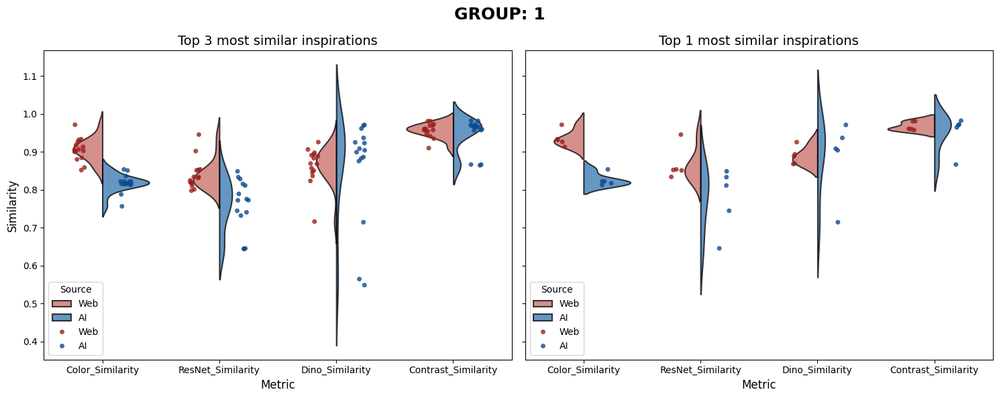

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,none
U-test top 1,Web,Web,none,none
Mean_diff test,Web,Web,none,none
Decision of Weighted voting,Strongly Web,Strongly Web,Weakly AI,Weakly Web
Strength of Weighted voting,4.676780,1.852605,0.196811,0.929229


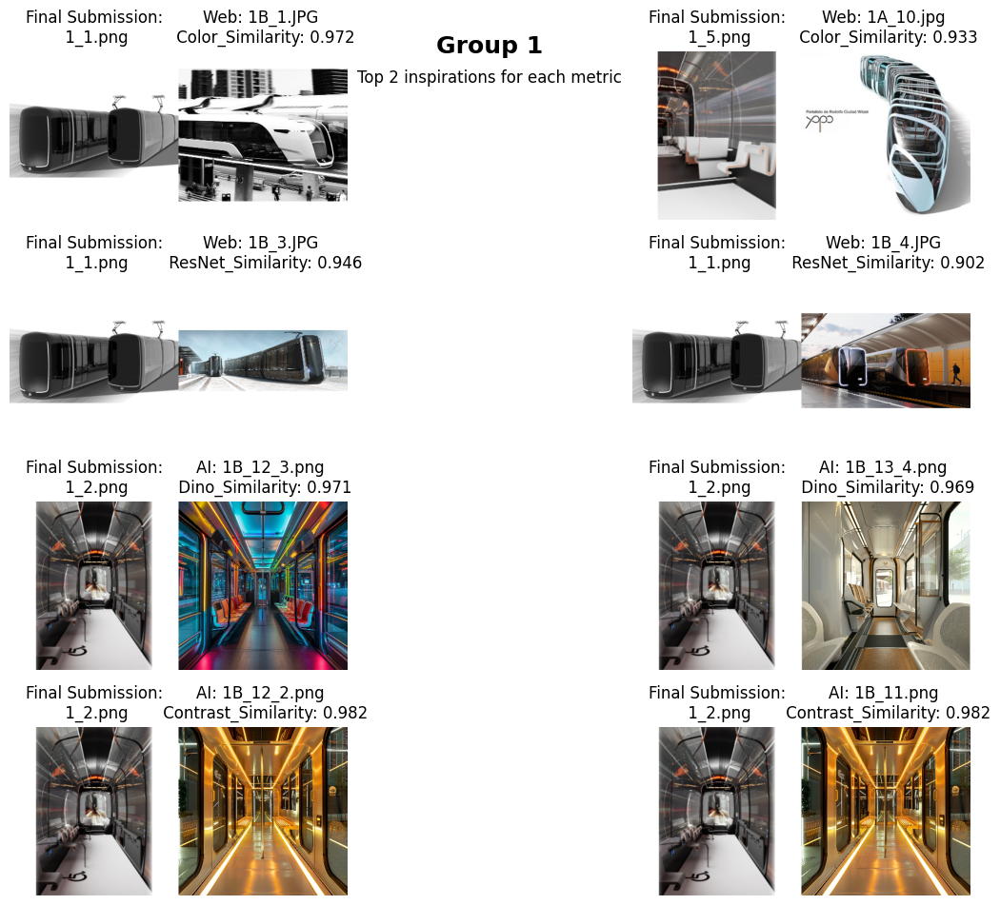

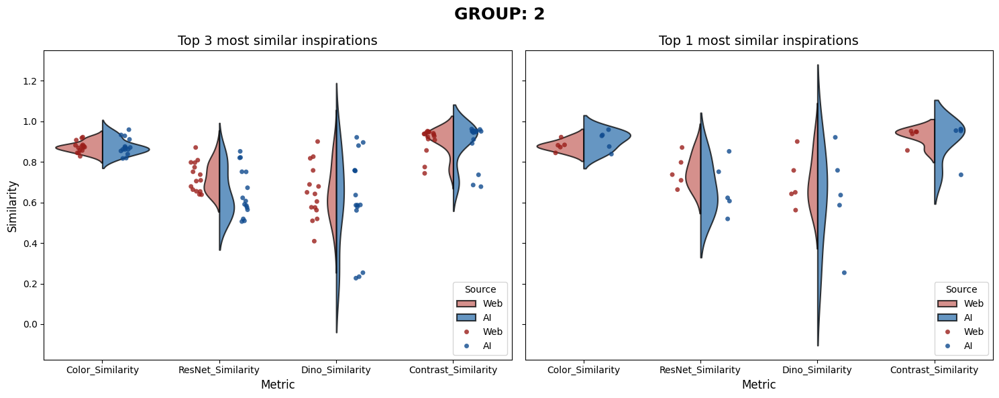

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,Web,Web,none
Decision of Weighted voting,Weakly AI,Strongly Web,Strongly AI,Weakly Web
Strength of Weighted voting,1.028308,2.877846,1.049463,0.820776


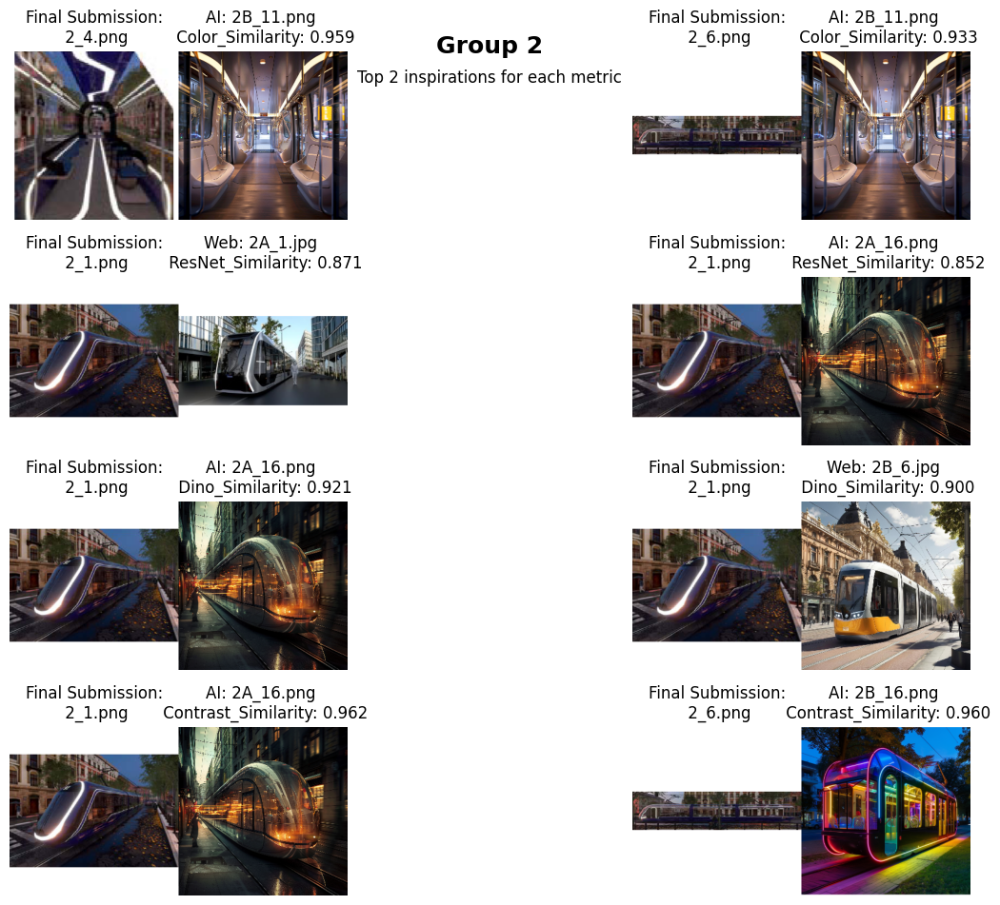

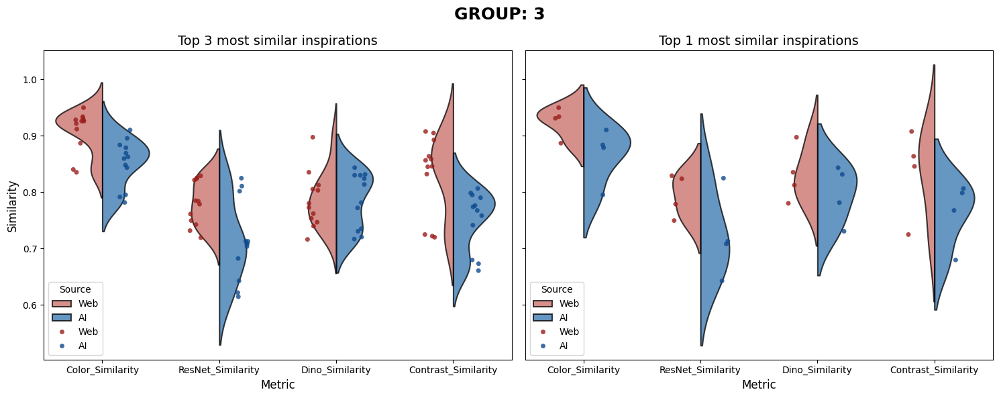

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,Web
U-test top 1,none,none,none,none
Mean_diff test,Web,Web,none,Web
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Strongly Web
Strength of Weighted voting,3.684667,2.364945,1.709604,3.339287


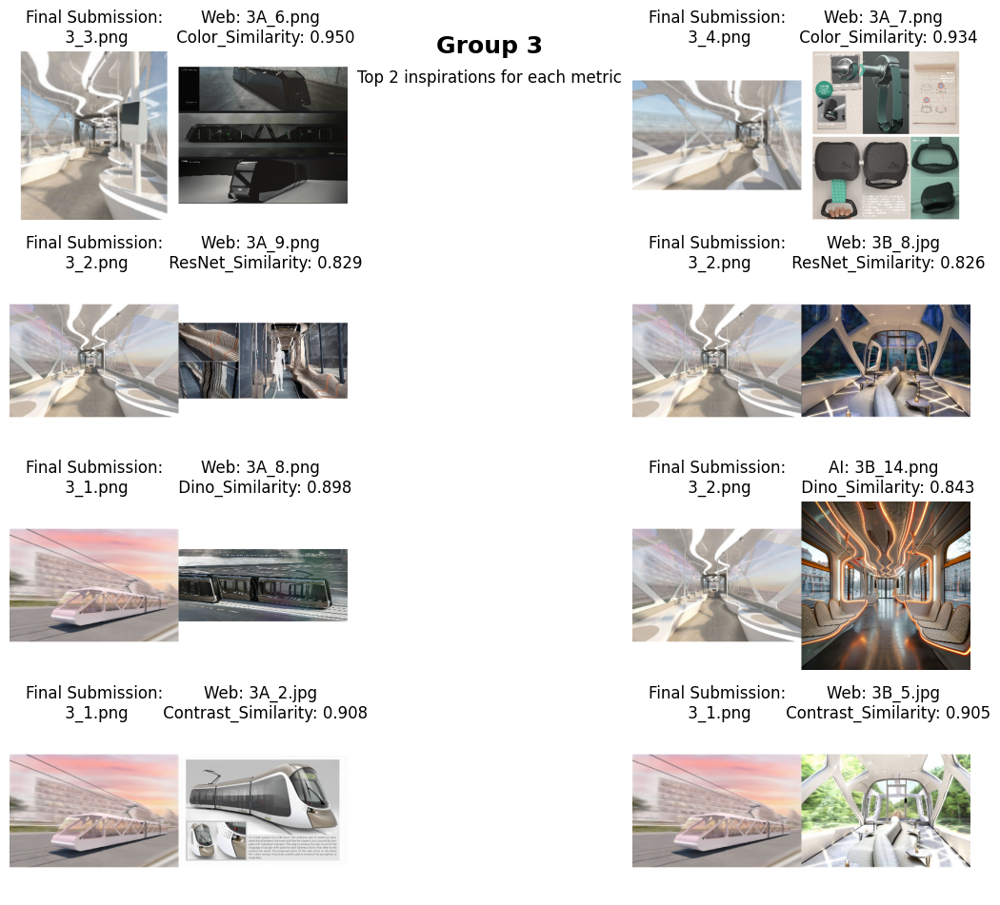

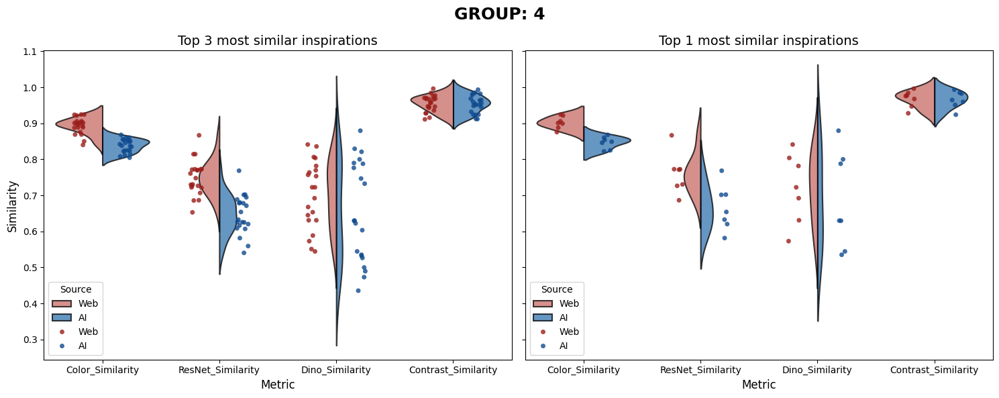

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,none
U-test top 1,Web,Web,none,none
Mean_diff test,Web,Web,none,none
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Weakly Web
Strength of Weighted voting,5.456400,5.325219,2.053410,0.017045


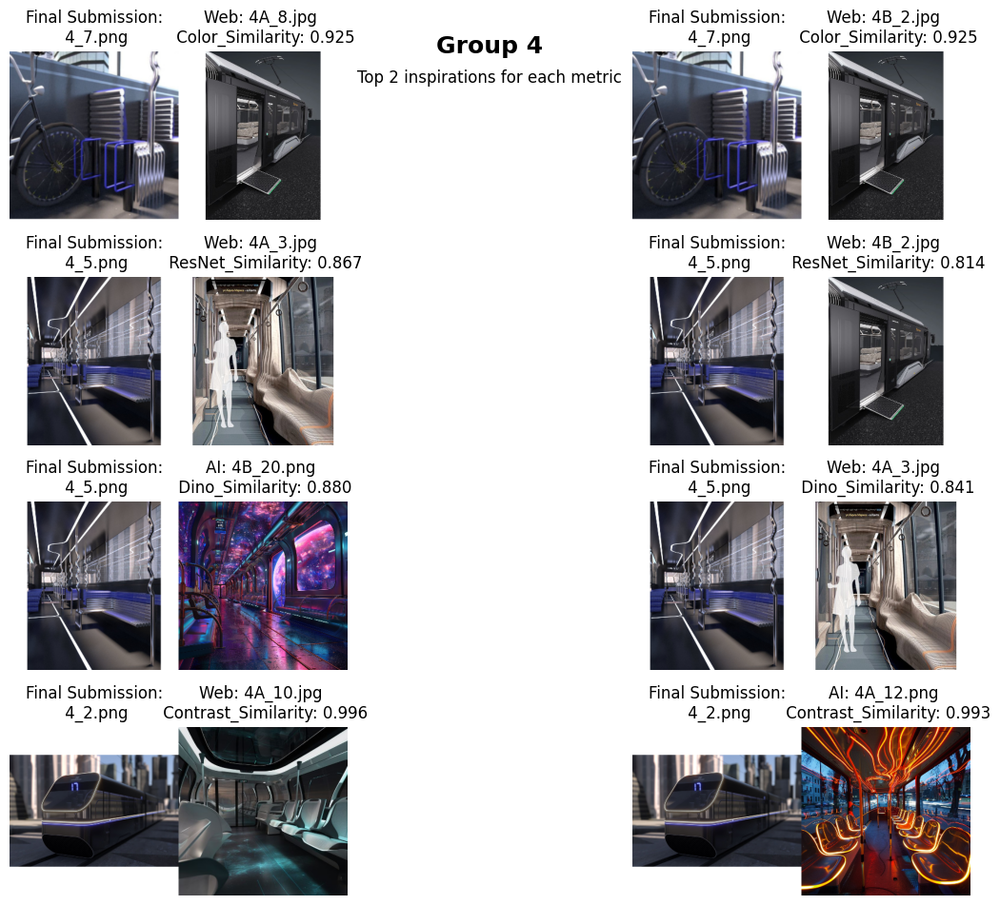

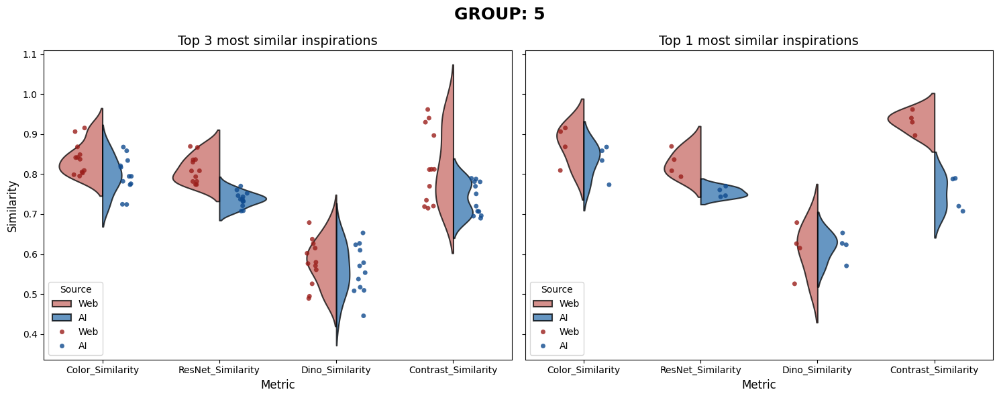

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,Web
U-test top 1,none,Web,none,Web
Mean_diff test,none,Web,none,Web
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Strongly Web
Strength of Weighted voting,1.725195,3.299223,1.849676,3.727788


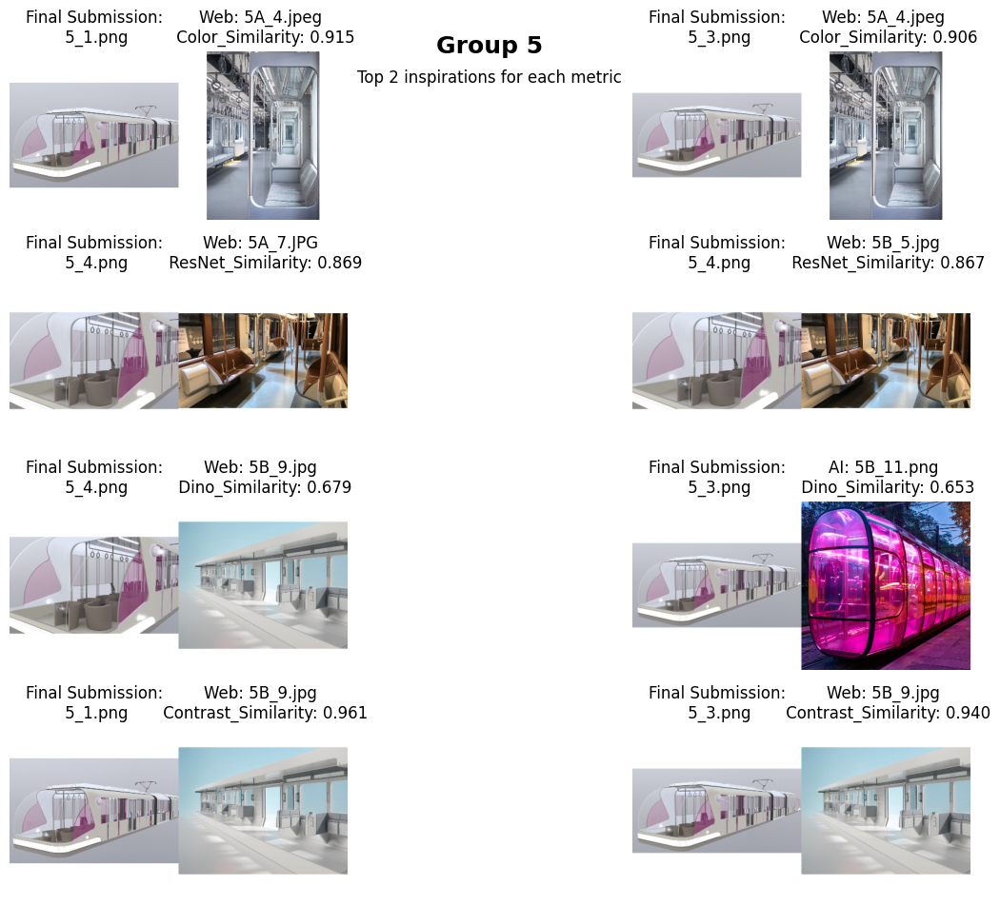

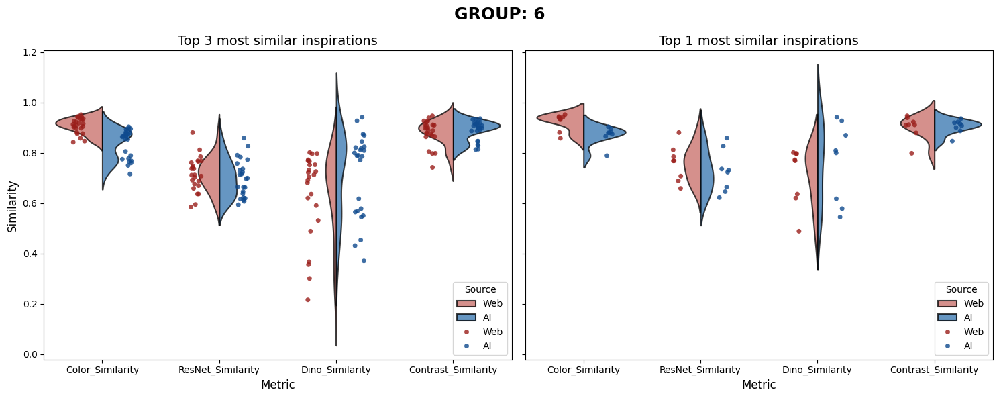

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,AI,none
U-test top 1,Web,none,none,none
Mean_diff test,Web,none,AI,none
Decision of Weighted voting,Strongly Web,Weakly Web,Strongly AI,Weakly AI
Strength of Weighted voting,6.476408,0.690446,5.437664,0.783258


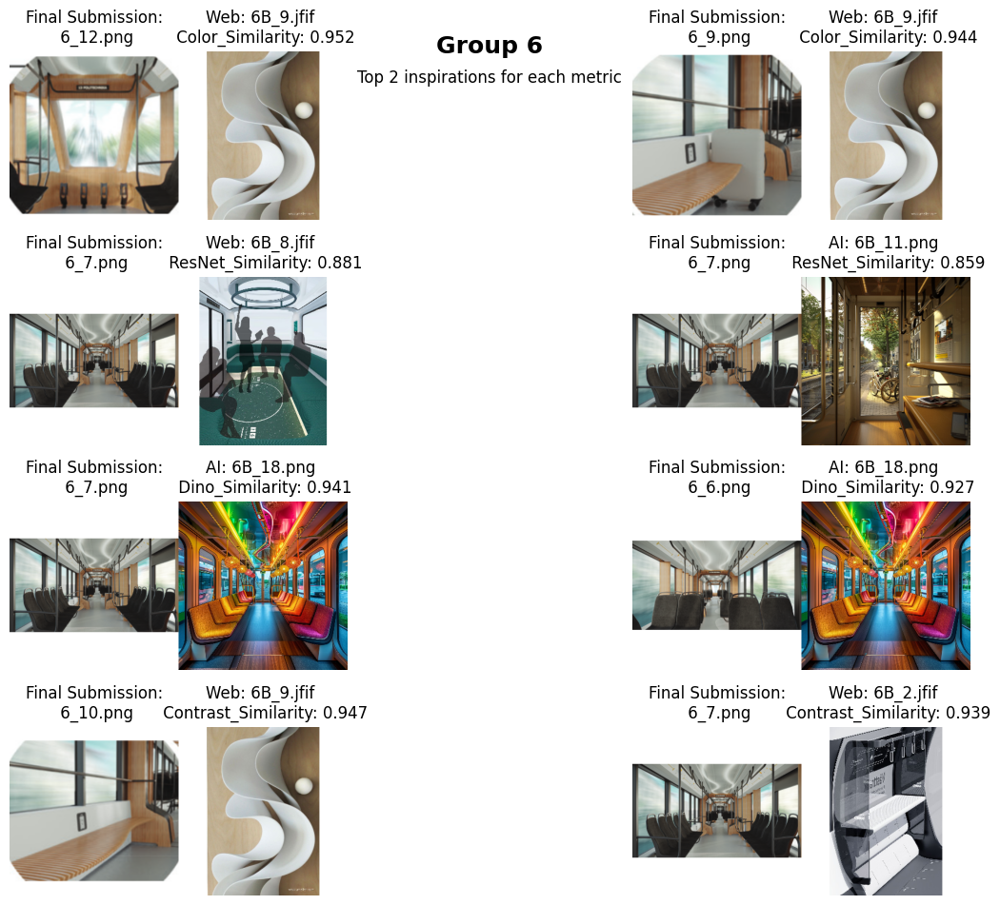

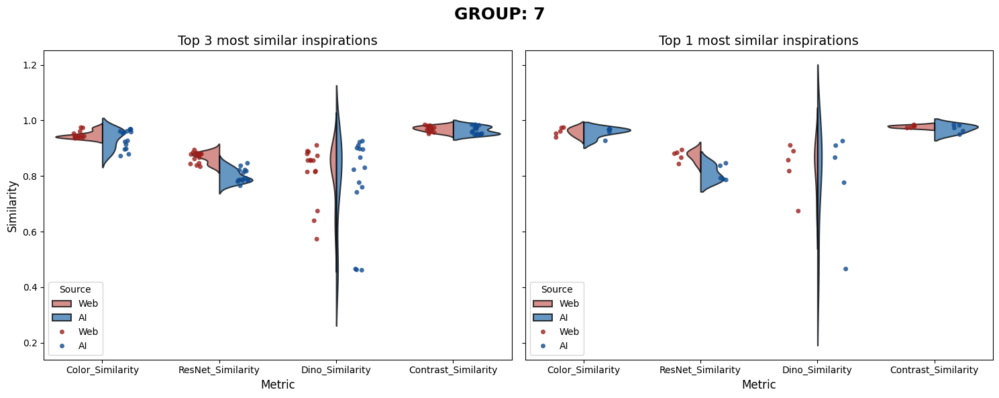

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,Web,none,none
U-test top 1,none,Web,none,none
Mean_diff test,none,Web,none,none
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Weakly Web
Strength of Weighted voting,1.936972,3.527534,1.455020,0.026914


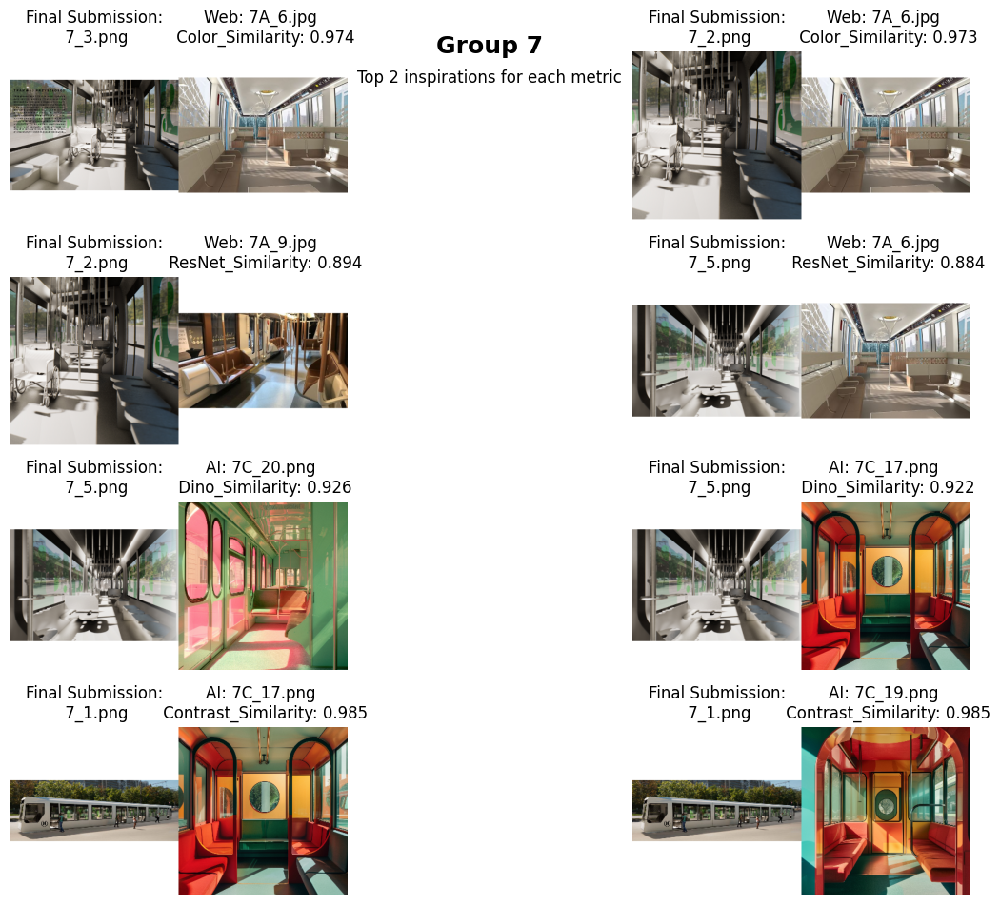

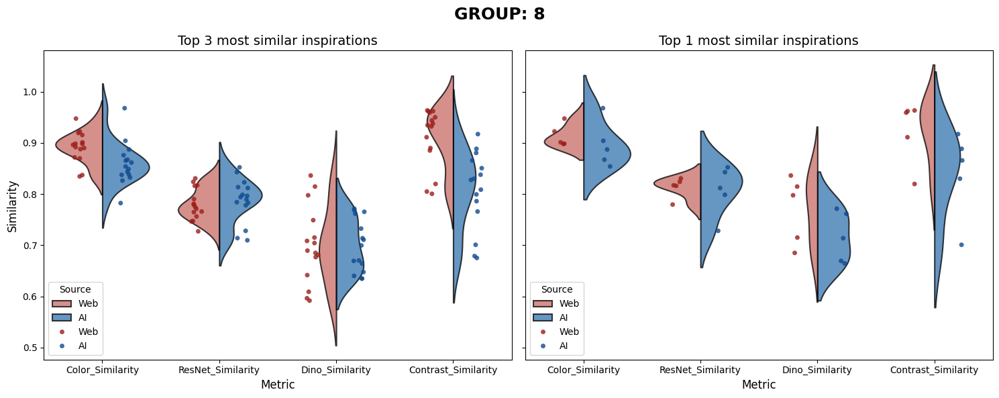

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,none,Web
U-test top 1,none,none,none,none
Mean_diff test,none,none,Web,Web
Decision of Weighted voting,Strongly Web,Weakly Web,Strongly Web,Strongly Web
Strength of Weighted voting,1.807384,0.703501,1.710598,4.607116


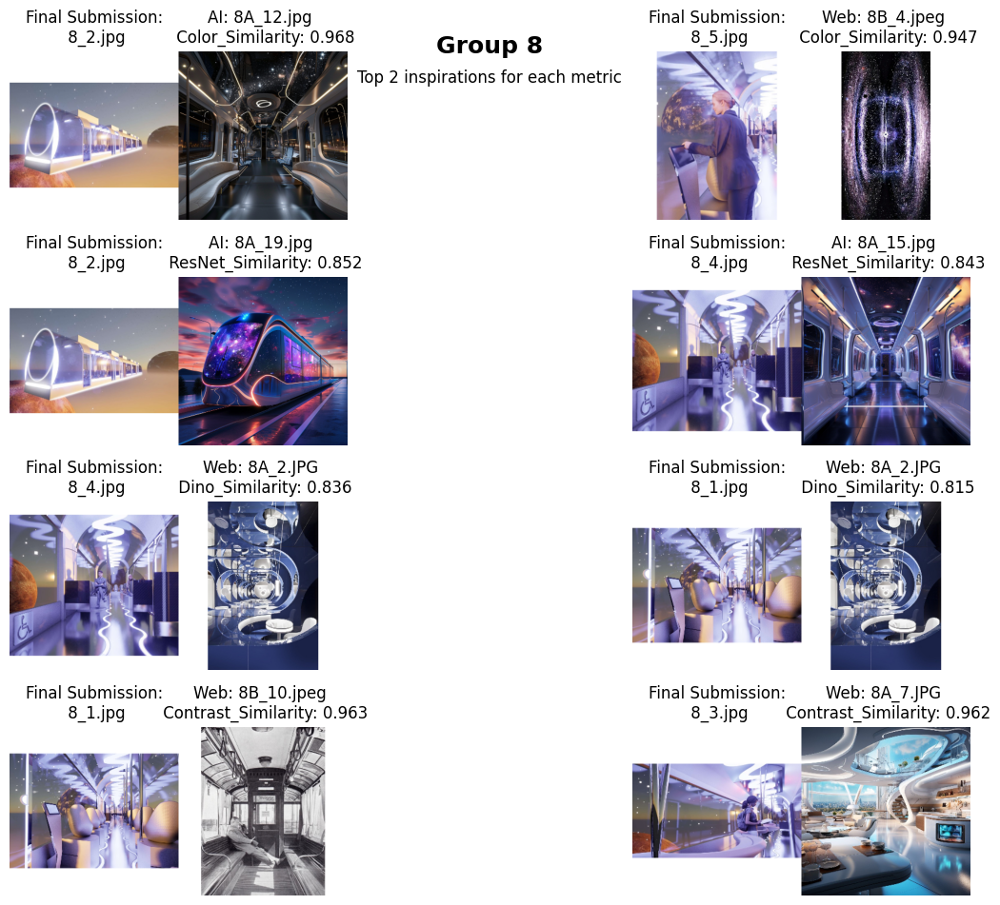

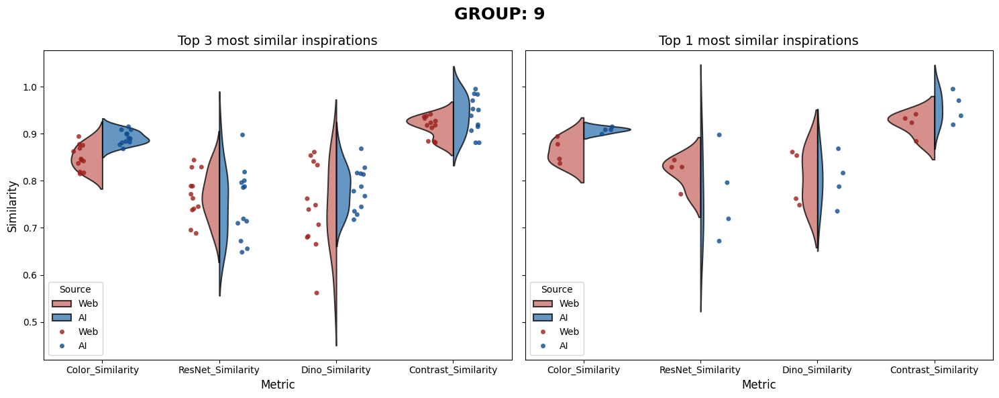

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,AI,none,none,none
U-test top 1,AI,none,none,none
Mean_diff test,none,none,none,none
Decision of Weighted voting,Strongly AI,Weakly Web,Strongly AI,Weakly AI
Strength of Weighted voting,1.857267,0.704650,1.556238,1.039620


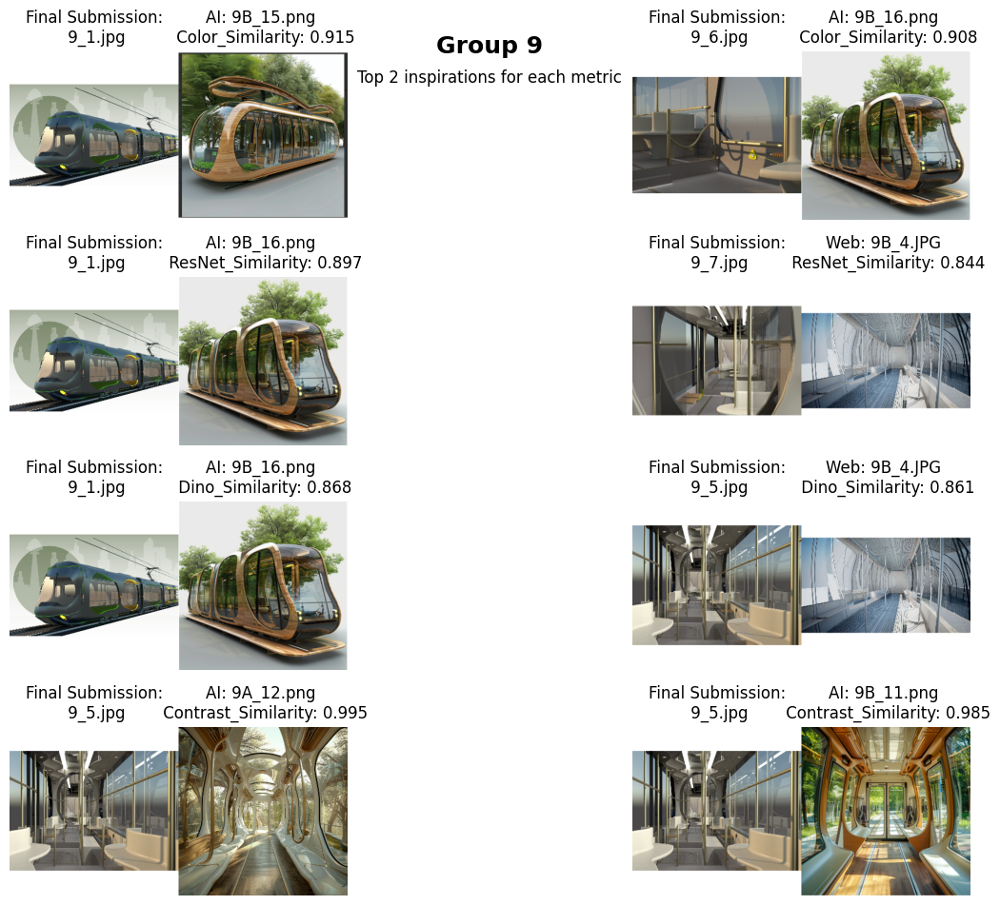

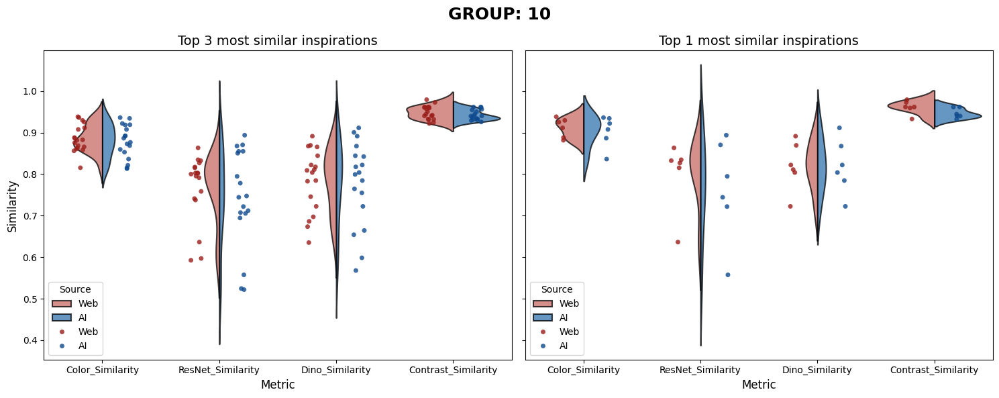

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,none,none,none
Decision of Weighted voting,Weakly Web,Weakly Web,Weakly AI,Weakly Web
Strength of Weighted voting,0.931138,0.587394,0.167499,0.036565


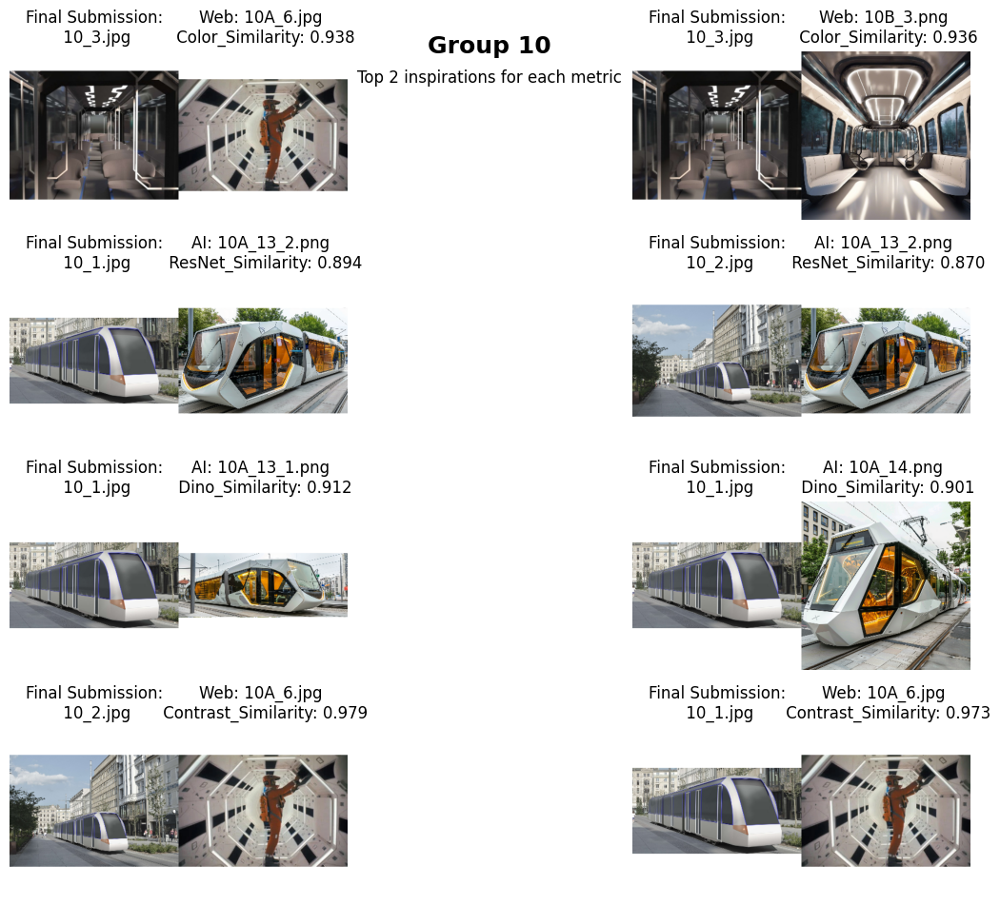

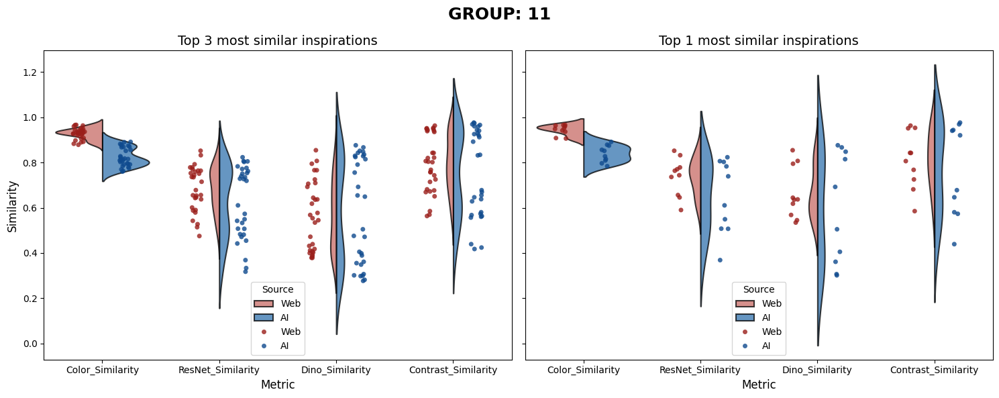

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,none,none
U-test top 1,Web,none,none,none
Mean_diff test,Web,Web,Web,none
Decision of Weighted voting,Strongly Web,Strongly Web,Weakly Web,Strongly Web
Strength of Weighted voting,8.555492,1.850678,0.409937,1.677317


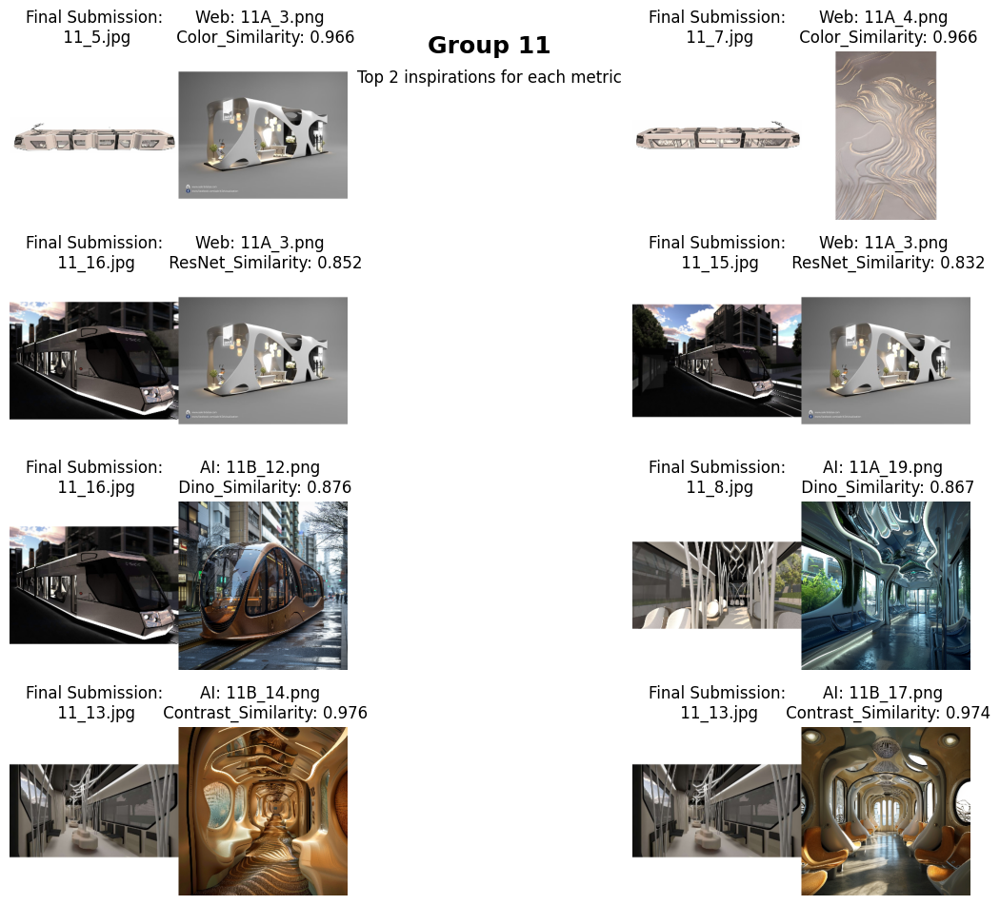

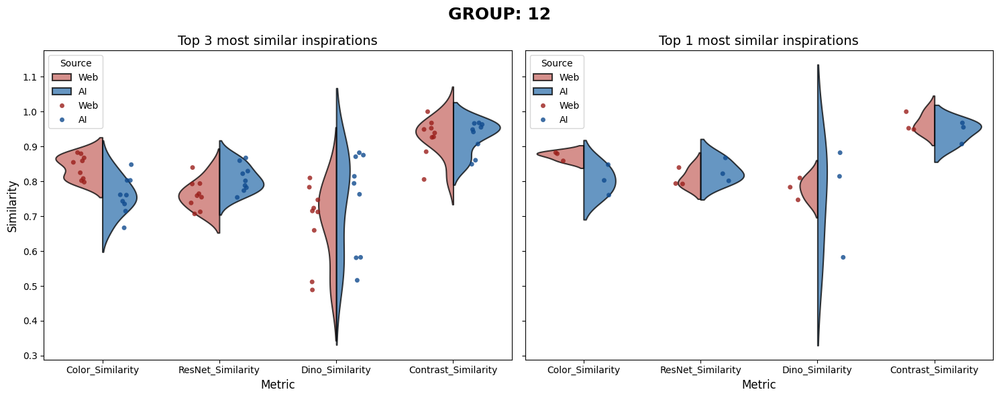

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,Web,none,none,none
Decision of Weighted voting,Strongly Web,Strongly AI,Strongly AI,Weakly AI
Strength of Weighted voting,2.614924,1.683257,0.939707,0.002471


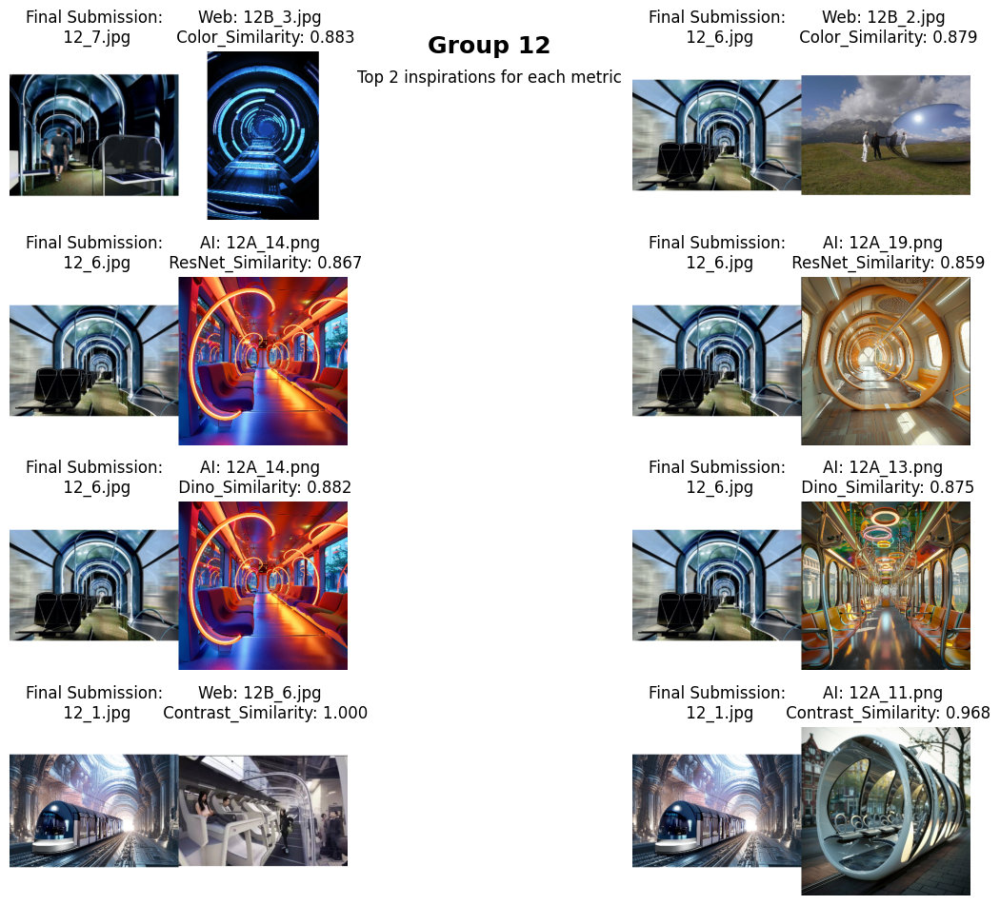

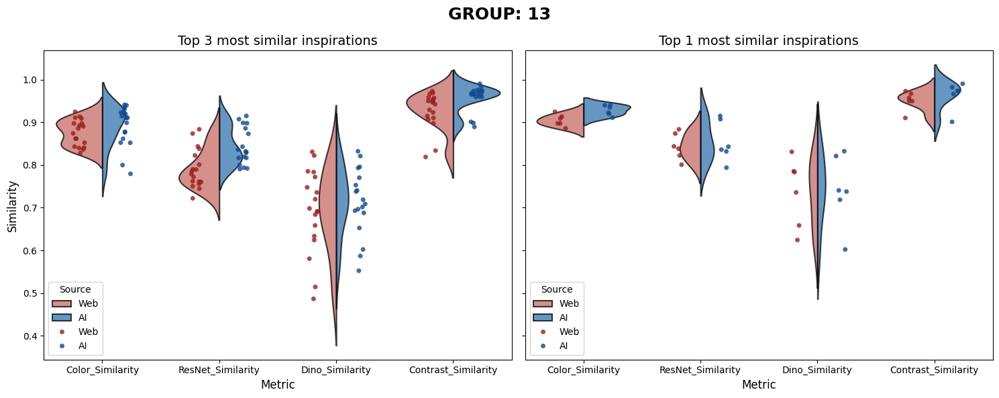

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,AI,none,AI
U-test top 1,AI,none,none,none
Mean_diff test,none,none,none,none
Decision of Weighted voting,Weakly AI,Strongly AI,Strongly Web,Strongly AI
Strength of Weighted voting,0.999249,2.641964,1.476442,2.906991


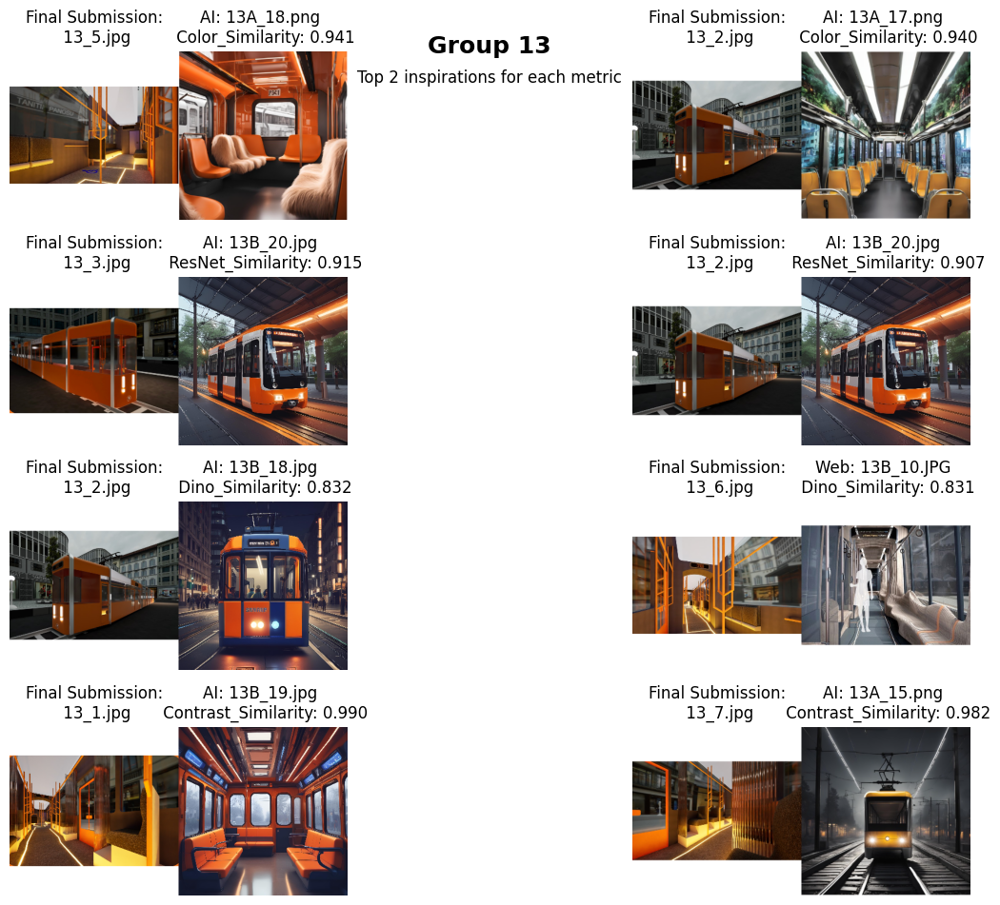

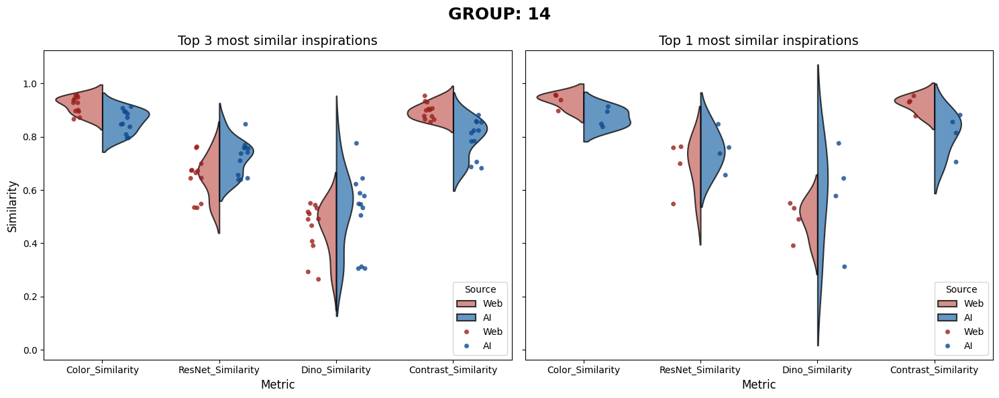

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,none,Web
U-test top 1,none,none,none,none
Mean_diff test,Web,AI,AI,Web
Decision of Weighted voting,Strongly Web,Weakly AI,Strongly AI,Strongly Web
Strength of Weighted voting,2.830229,0.863052,1.444174,2.789130


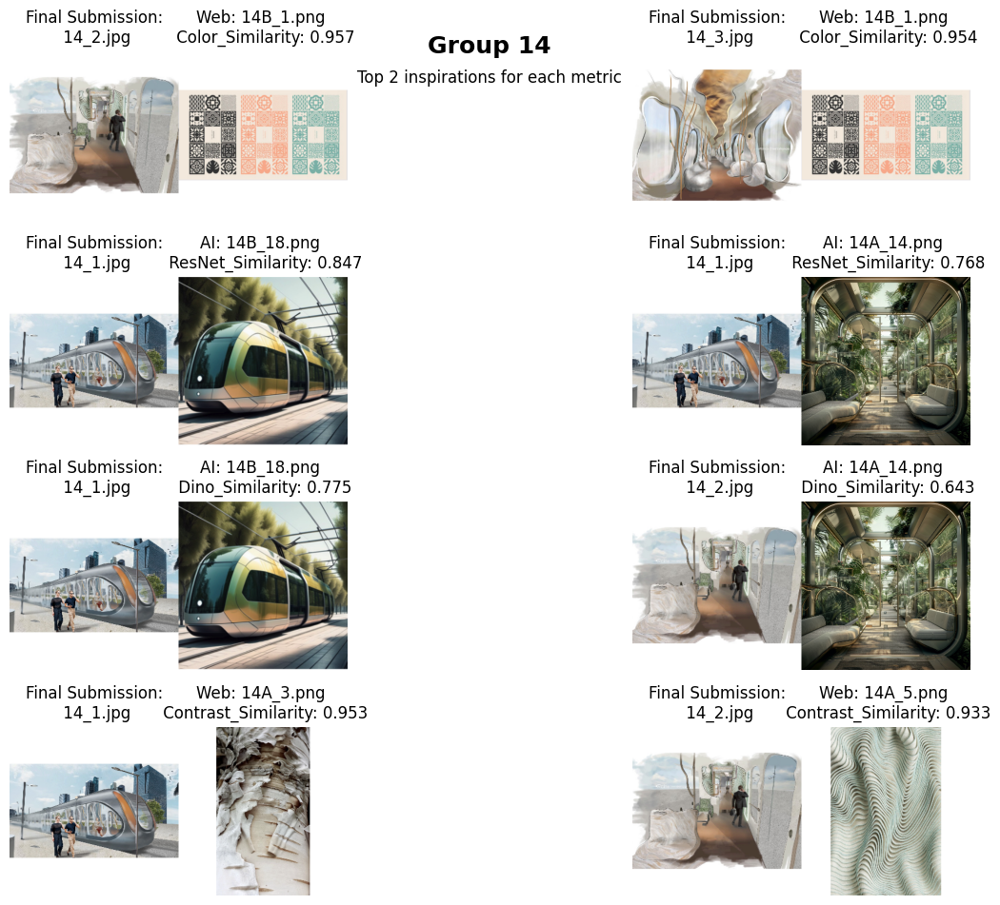

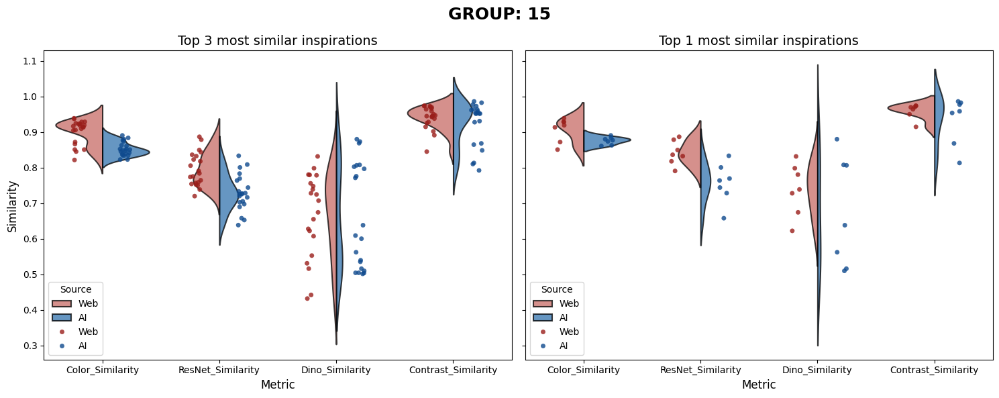

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,none
U-test top 1,none,Web,none,none
Mean_diff test,none,Web,Web,none
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Strongly Web
Strength of Weighted voting,4.620571,3.421097,1.828173,1.855306


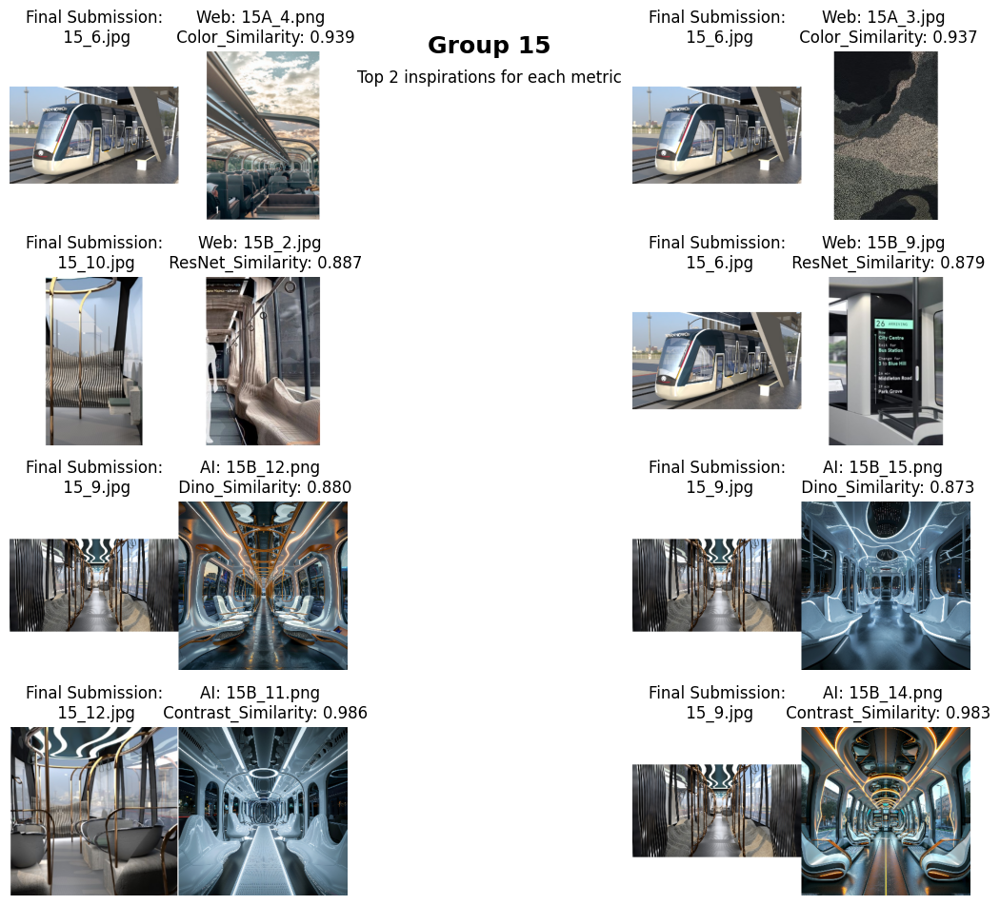

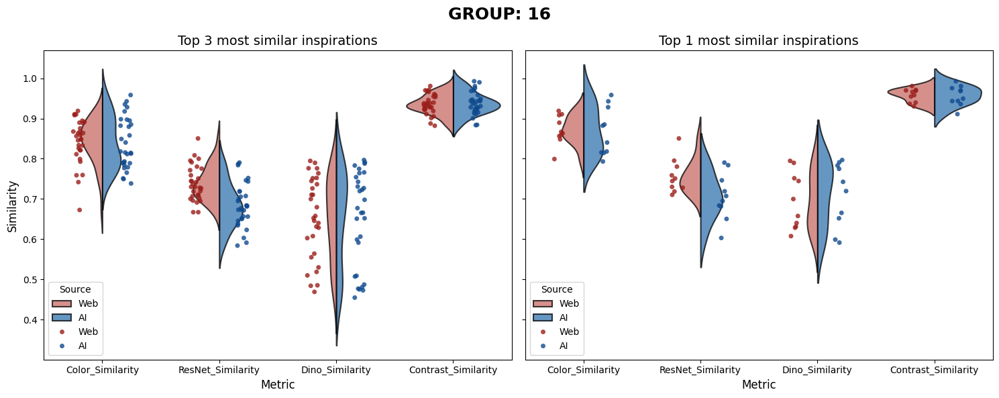

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,Web,none,none
U-test top 1,none,Web,none,none
Mean_diff test,none,Web,none,none
Decision of Weighted voting,Strongly Web,Strongly Web,Weakly AI,Weakly AI
Strength of Weighted voting,1.680025,4.594383,0.263202,0.975872


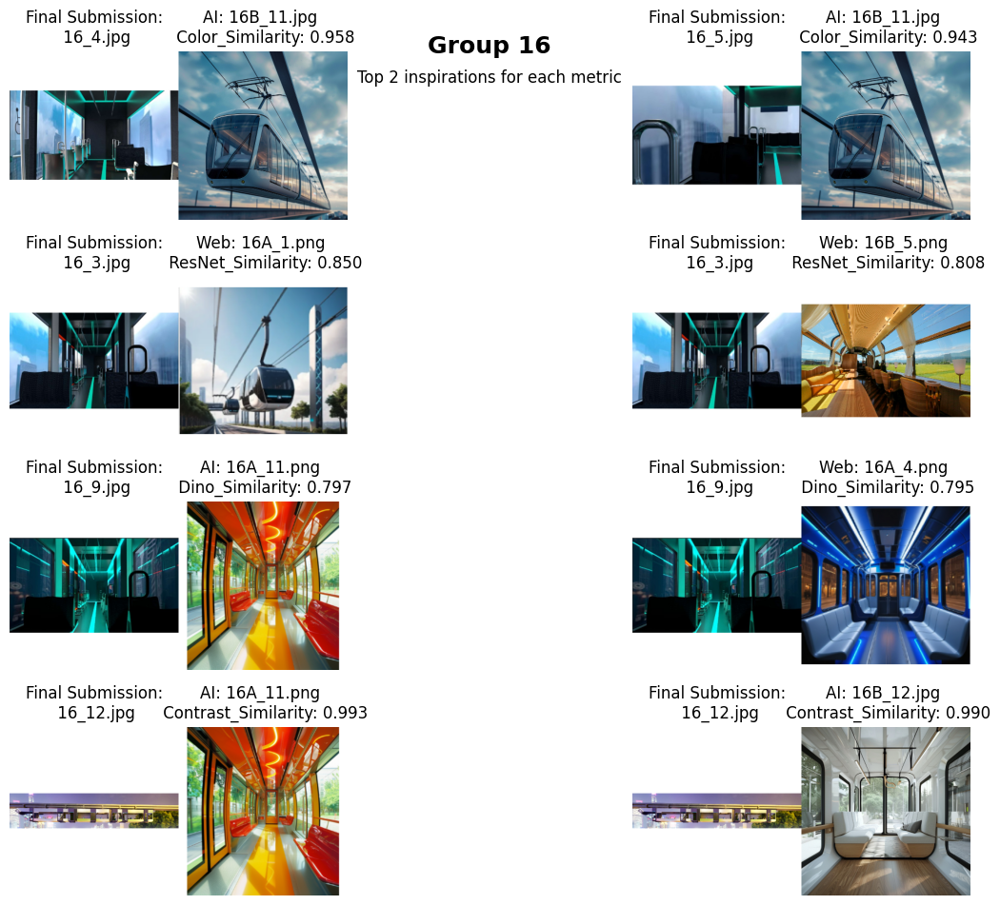

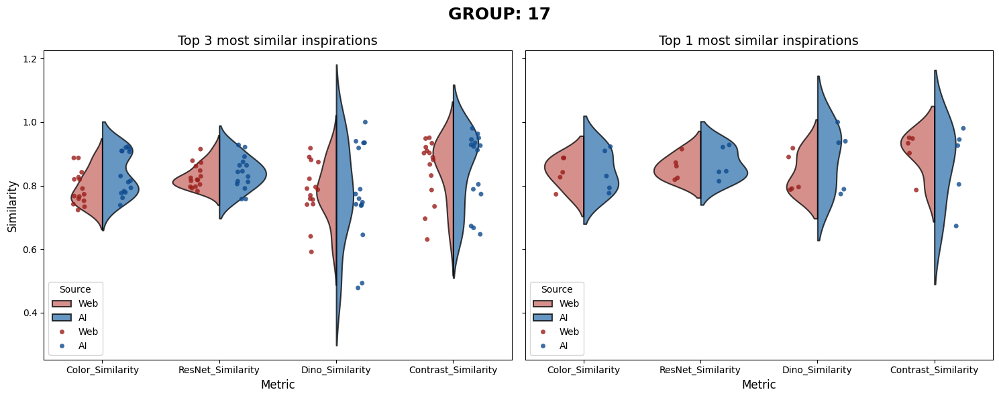

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,none,AI,none
Decision of Weighted voting,Strongly AI,Strongly AI,Strongly AI,Weakly AI
Strength of Weighted voting,2.617917,1.003541,2.860222,0.228177


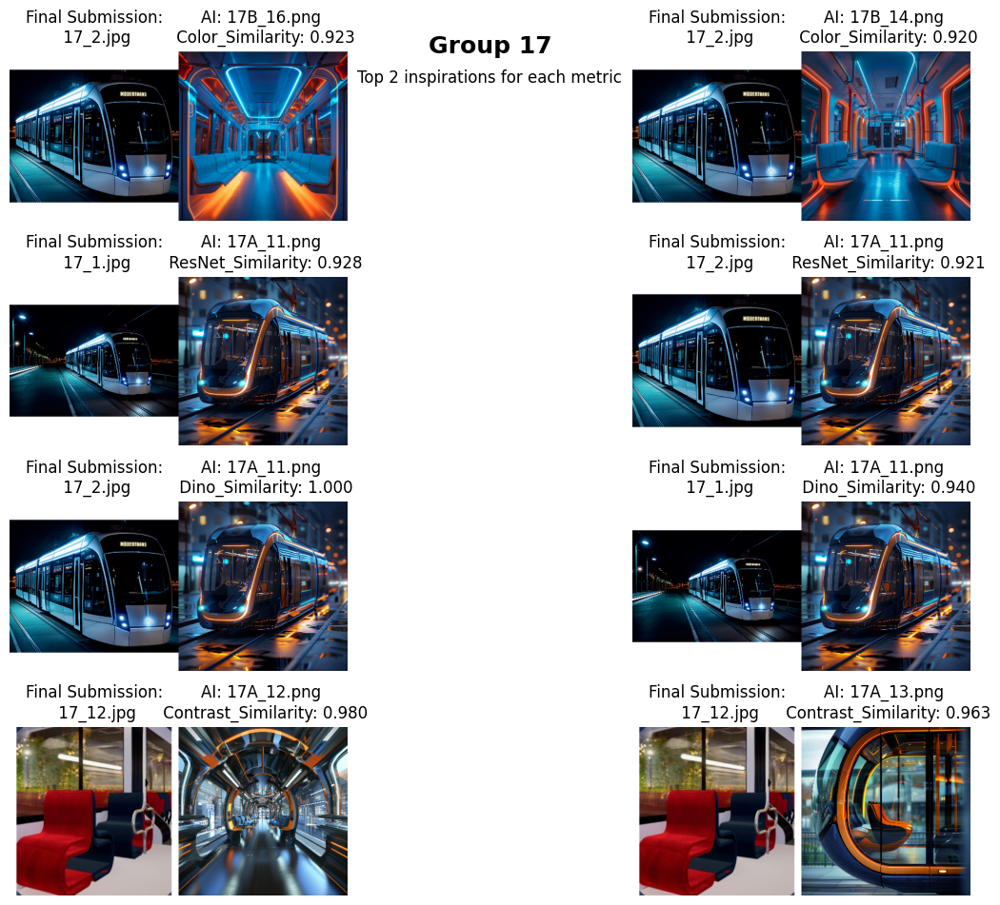

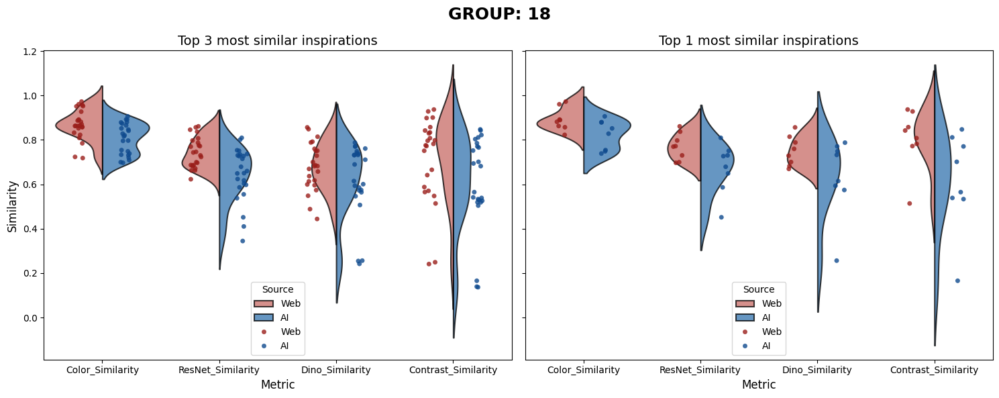

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,Web
U-test top 1,none,none,none,none
Mean_diff test,Web,Web,Web,Web
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly Web,Strongly Web
Strength of Weighted voting,4.584019,5.363430,3.756463,4.789351


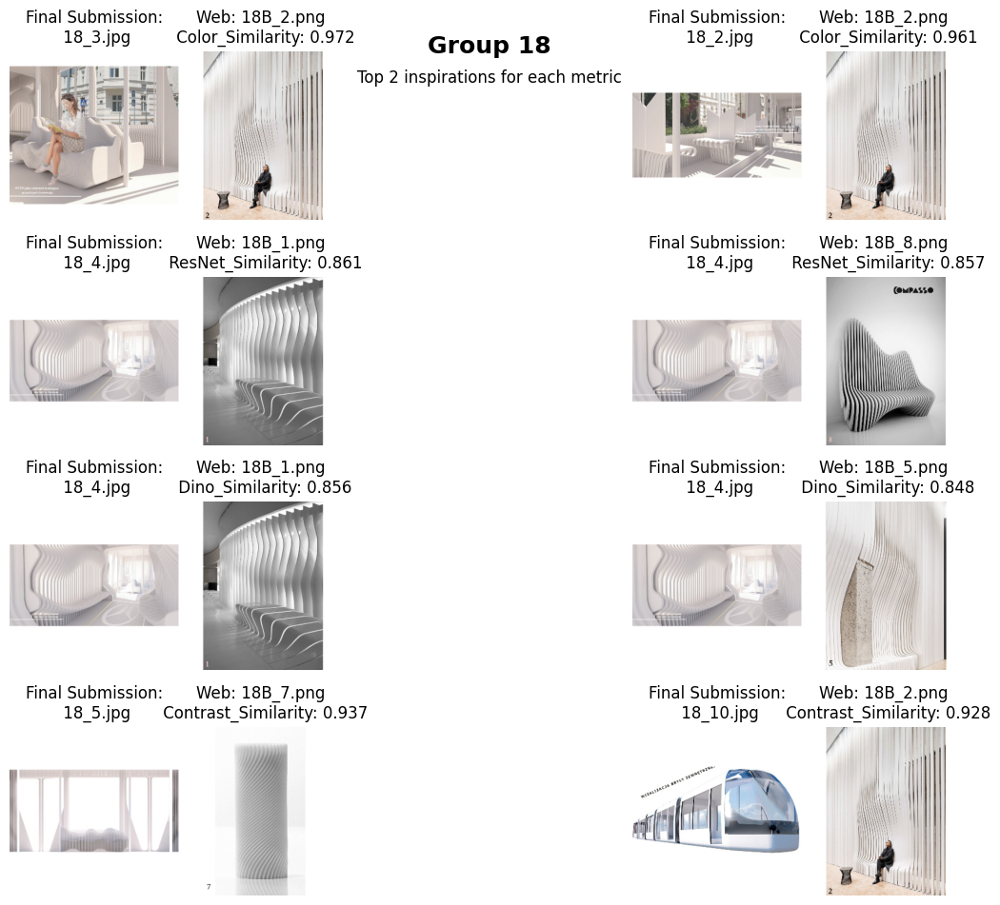

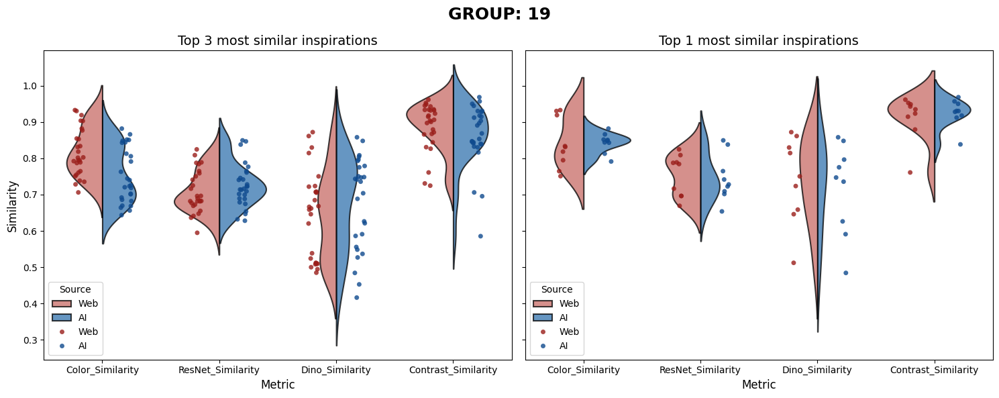

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,none,none,none
Decision of Weighted voting,Strongly Web,Weakly Web,Strongly AI,Weakly Web
Strength of Weighted voting,5.081722,0.672315,1.895843,0.993392


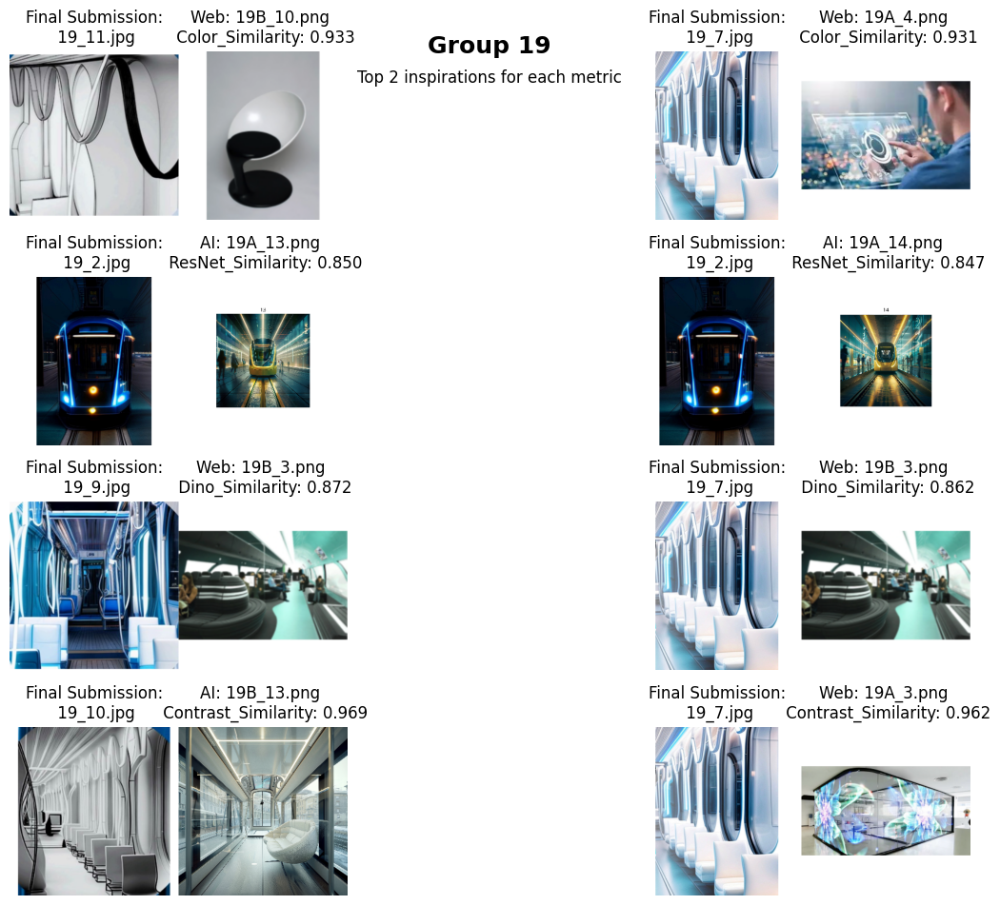

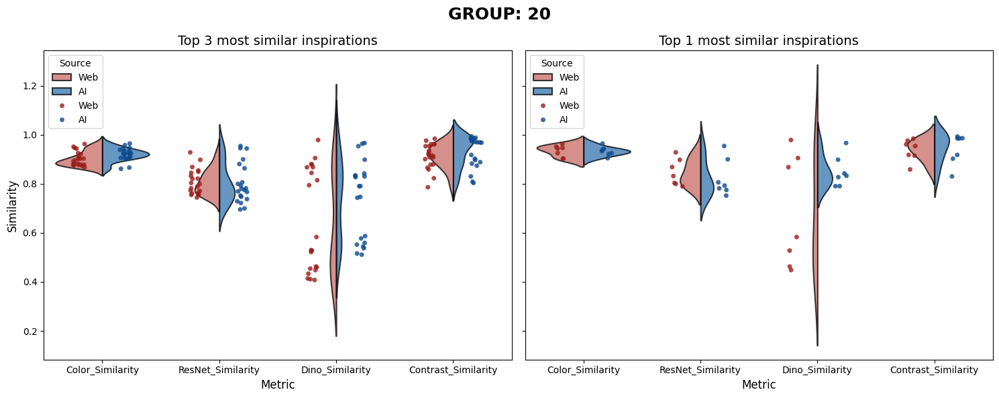

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,AI,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,none,AI,none
Decision of Weighted voting,Weakly AI,Strongly Web,Strongly AI,Strongly AI
Strength of Weighted voting,1.035985,1.444382,3.350948,2.015577


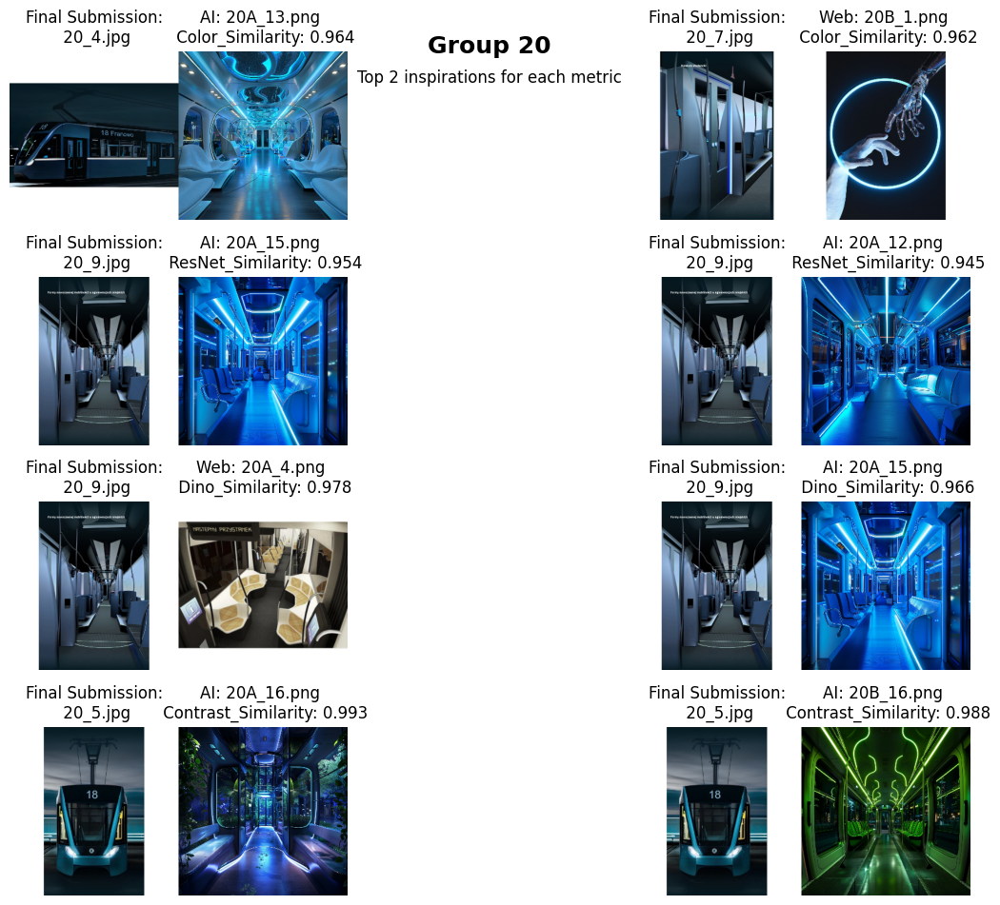

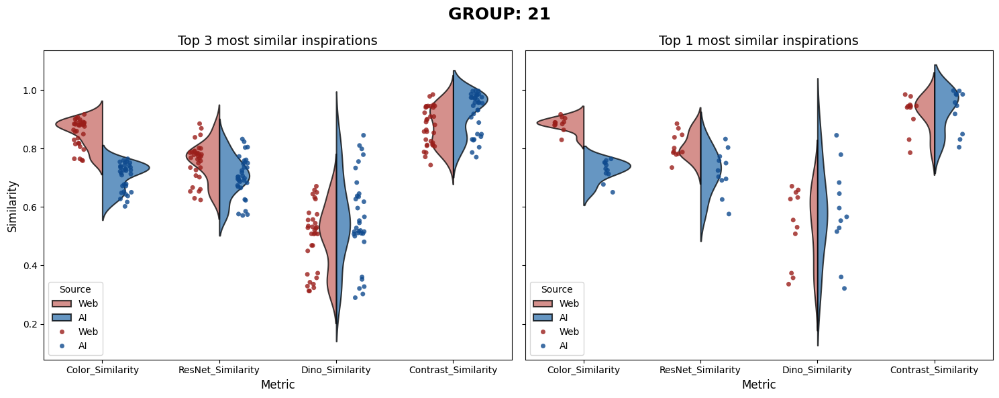

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,Web,none,AI
U-test top 1,Web,Web,none,none
Mean_diff test,Web,Web,none,none
Decision of Weighted voting,Strongly Web,Strongly Web,Strongly AI,Strongly AI
Strength of Weighted voting,9.733131,4.277819,3.224751,4.826761


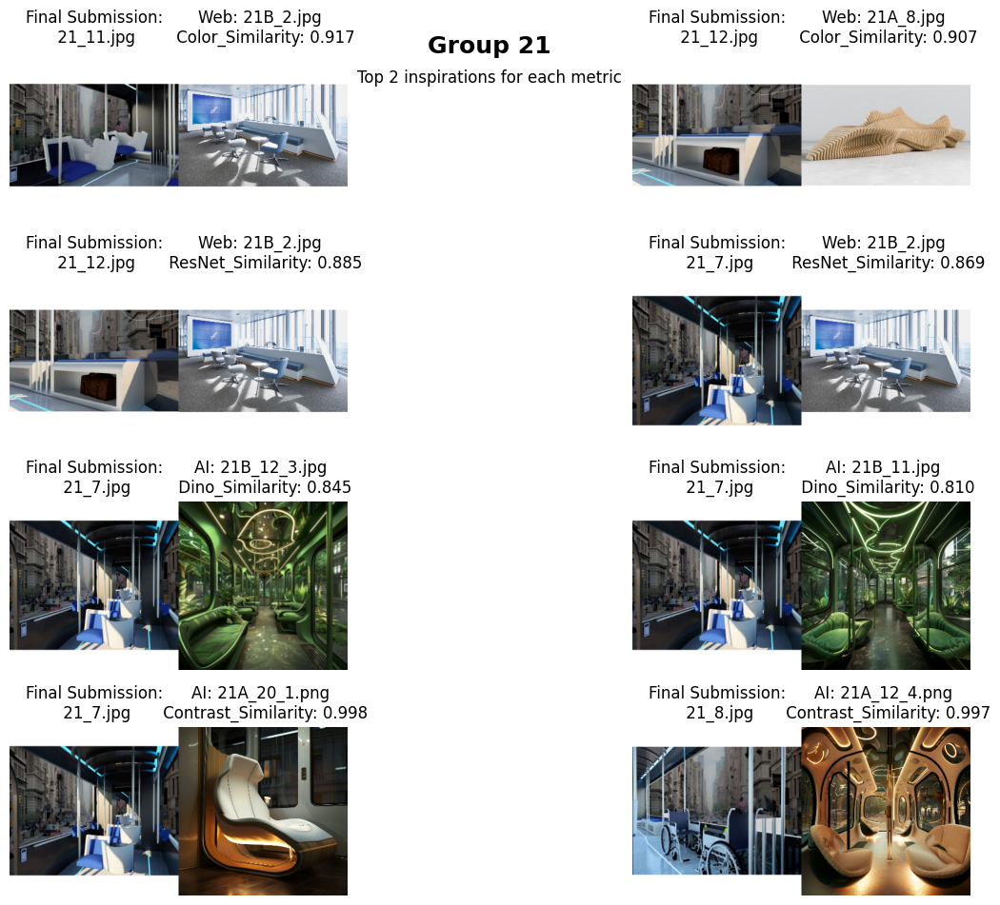

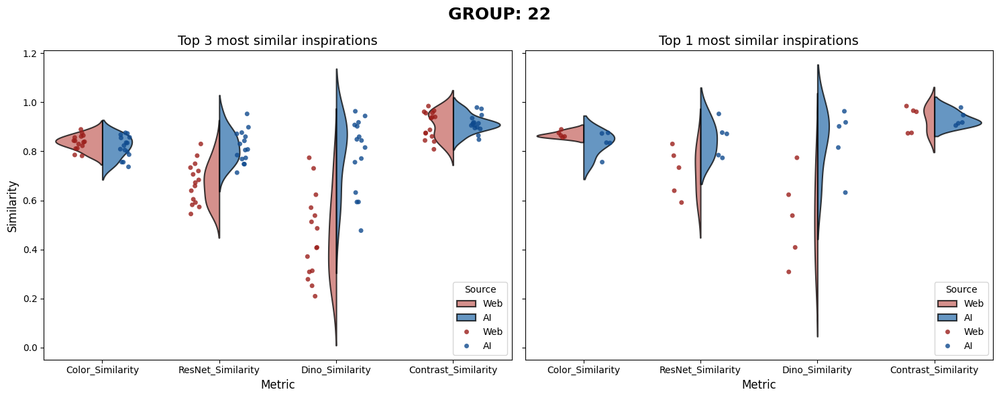

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,AI,AI,none
U-test top 1,none,none,AI,none
Mean_diff test,none,AI,AI,none
Decision of Weighted voting,Weakly Web,Strongly AI,Strongly AI,Weakly Web
Strength of Weighted voting,0.904152,2.654841,4.196018,0.010608


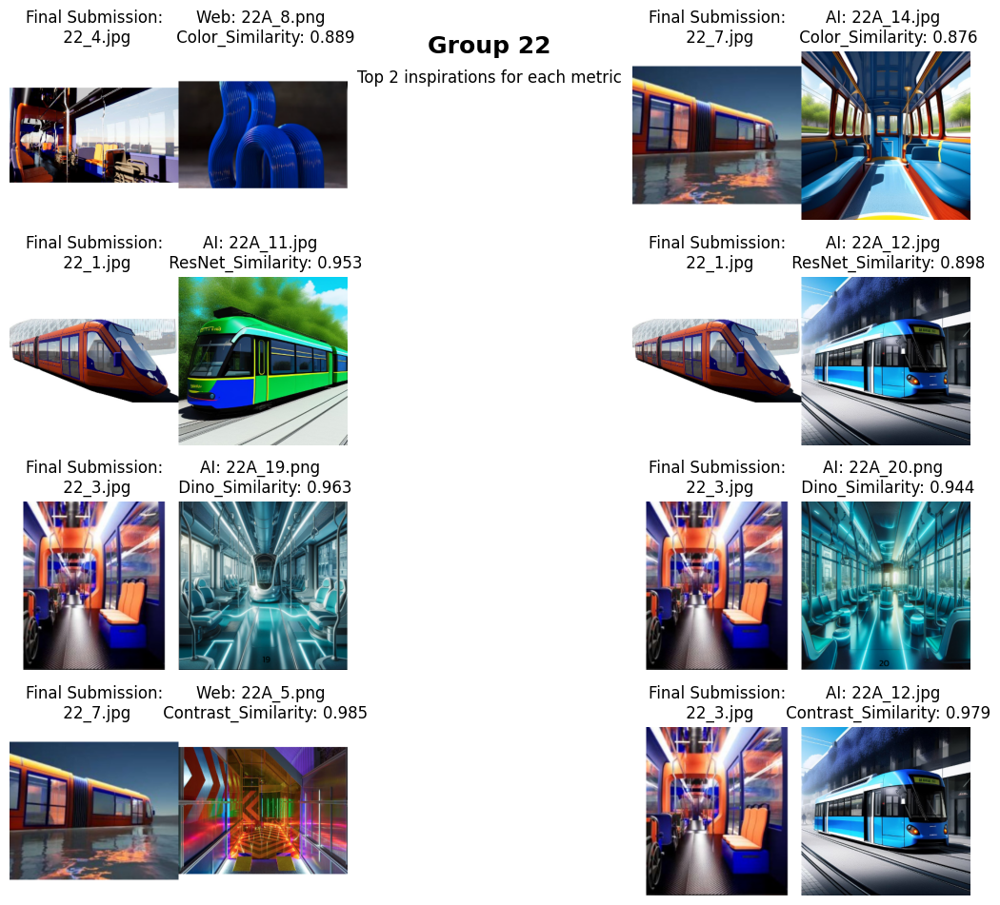

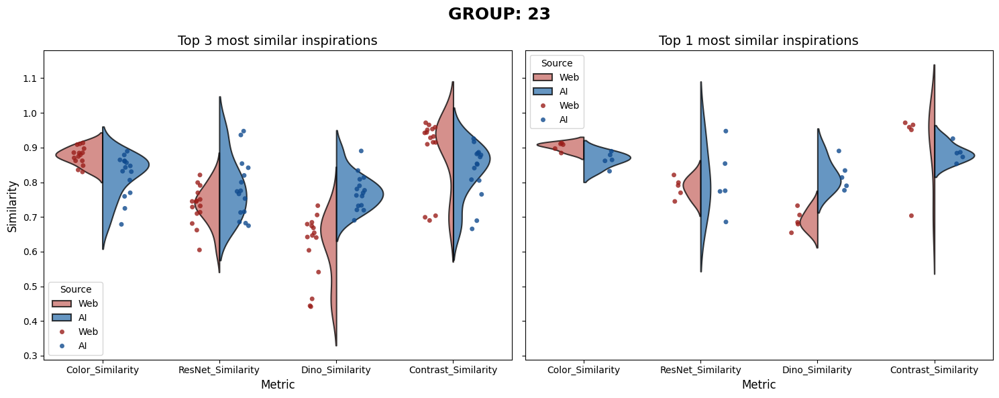

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,none,AI,Web
U-test top 1,Web,none,AI,none
Mean_diff test,none,none,AI,none
Decision of Weighted voting,Strongly Web,Strongly AI,Strongly AI,Strongly Web
Strength of Weighted voting,2.736514,1.805627,4.104312,2.966286


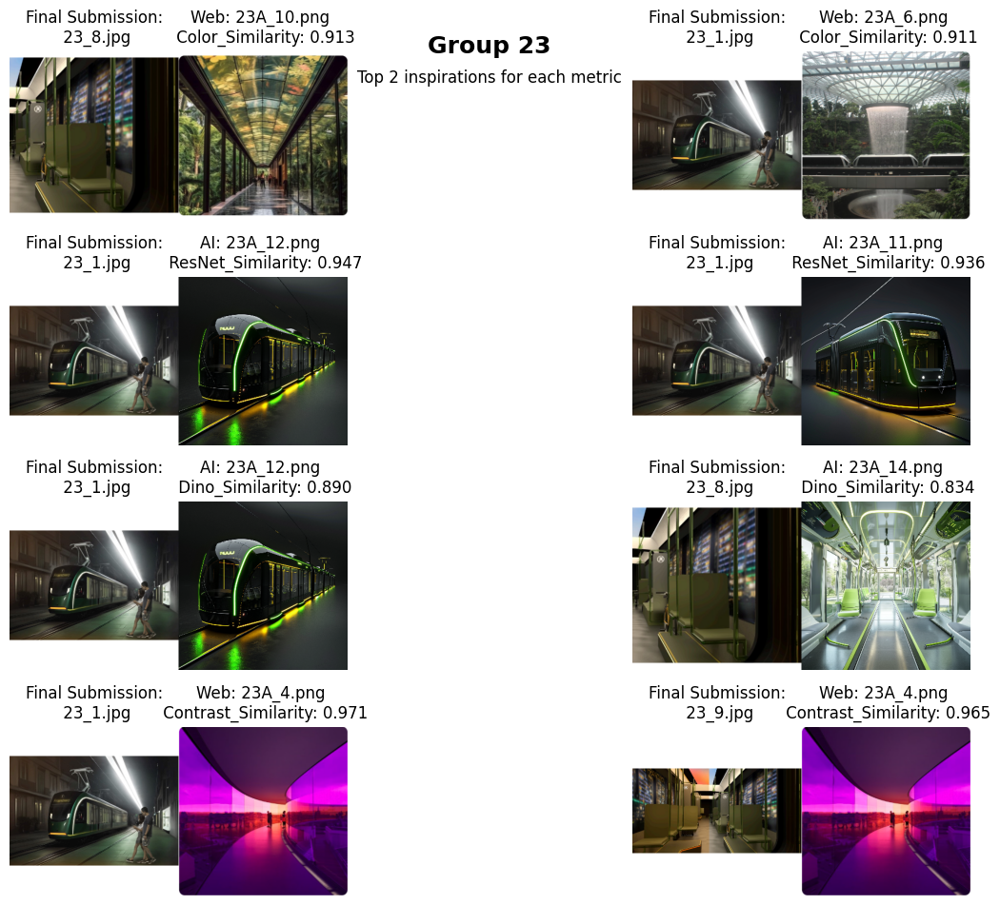

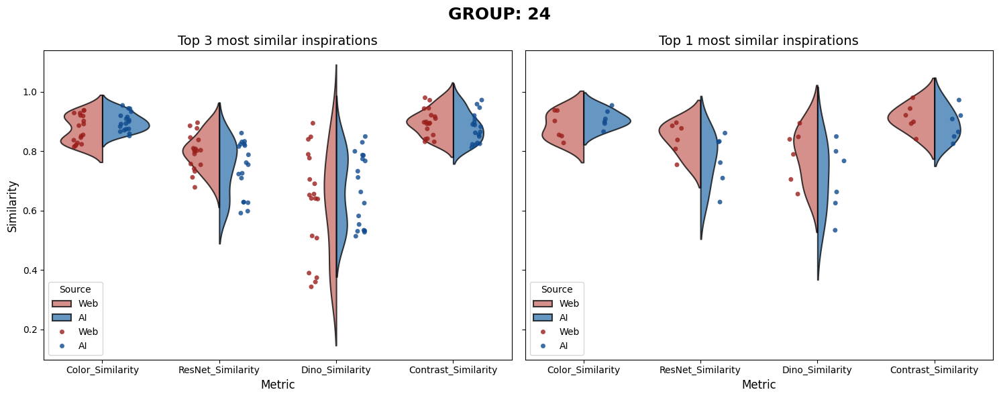

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,Web,Web,none
Decision of Weighted voting,Weakly AI,Weakly Web,Strongly Web,Strongly Web
Strength of Weighted voting,0.983015,0.076200,1.363456,1.835227


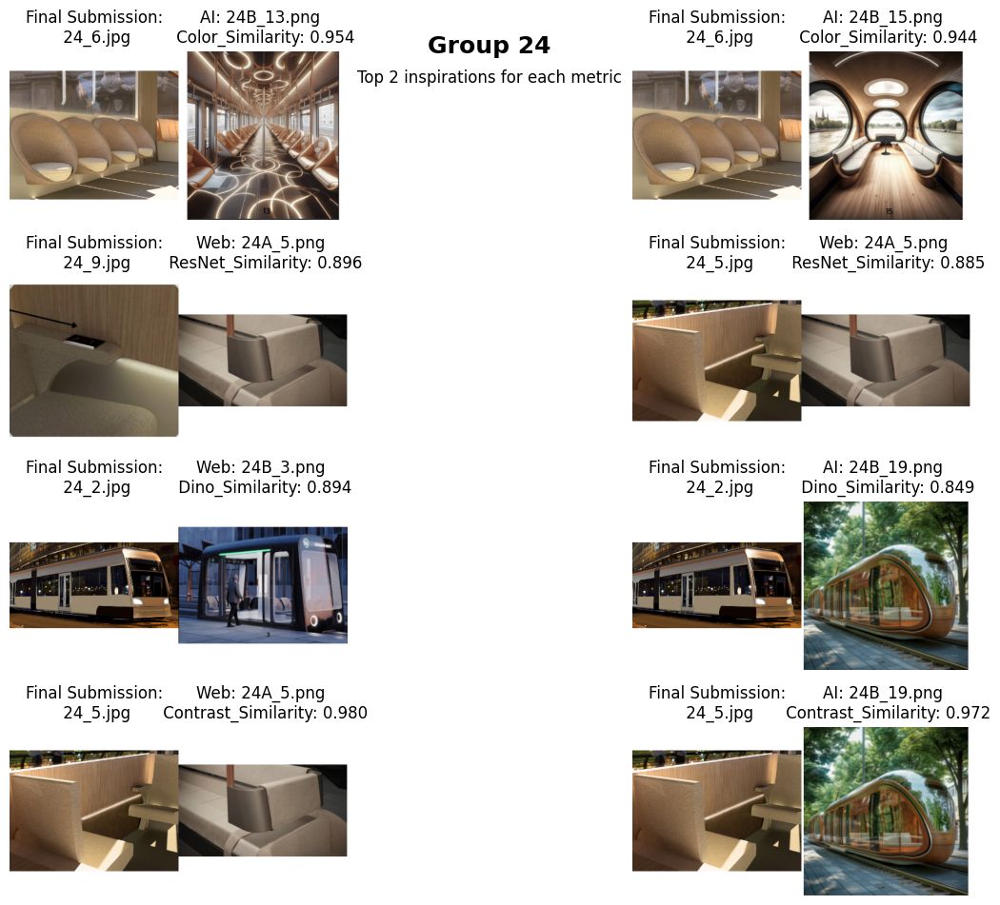

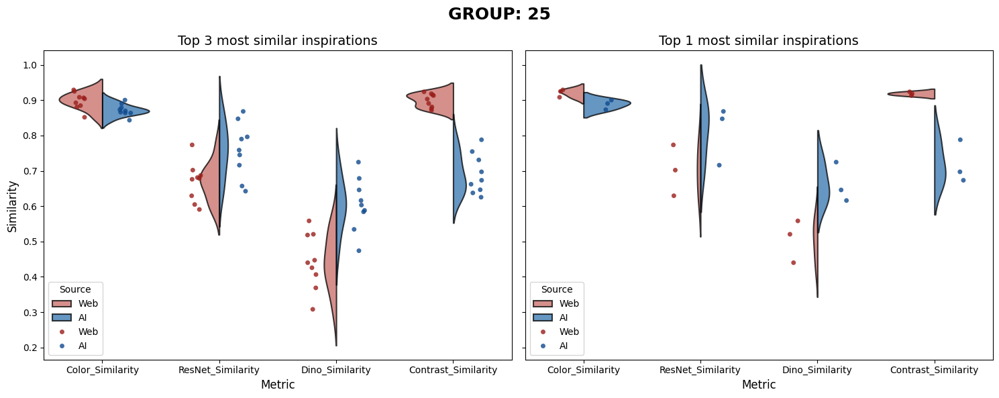

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,Web,AI,AI,Web
U-test top 1,none,none,none,none
Mean_diff test,none,AI,AI,Web
Decision of Weighted voting,Weakly Web,Strongly AI,Strongly AI,Strongly Web
Strength of Weighted voting,0.077729,1.701259,1.986751,2.755556


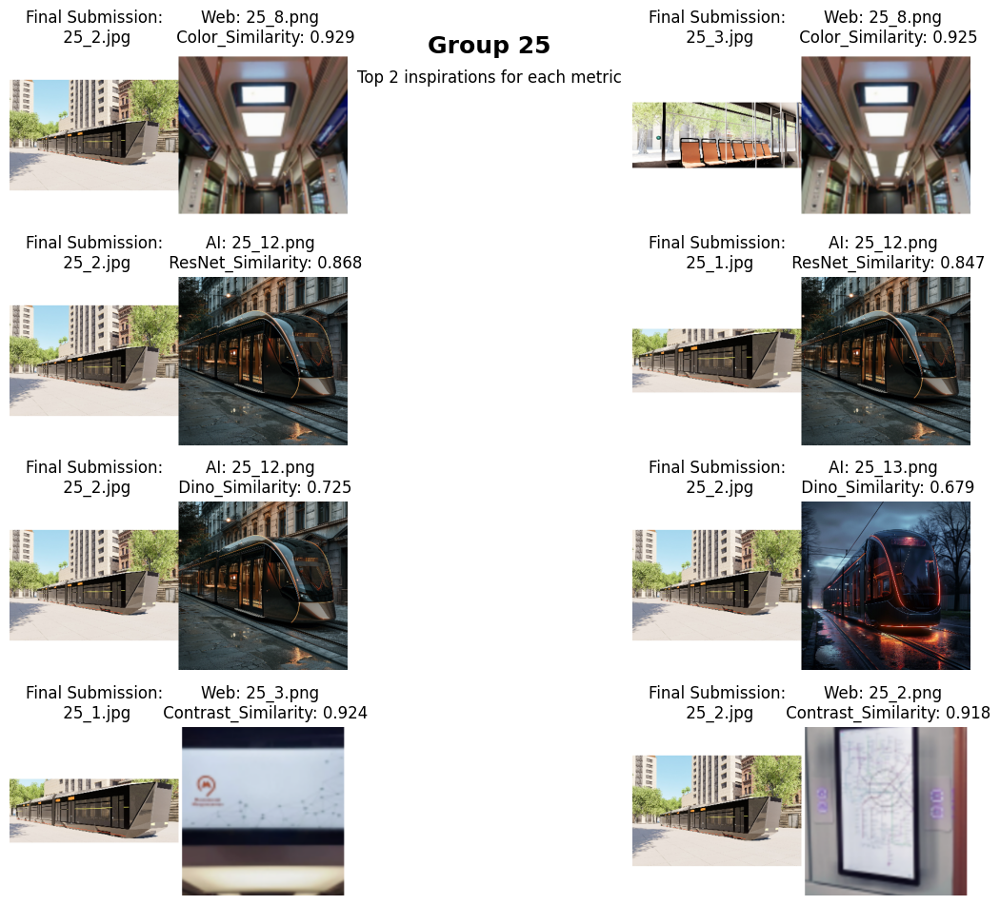

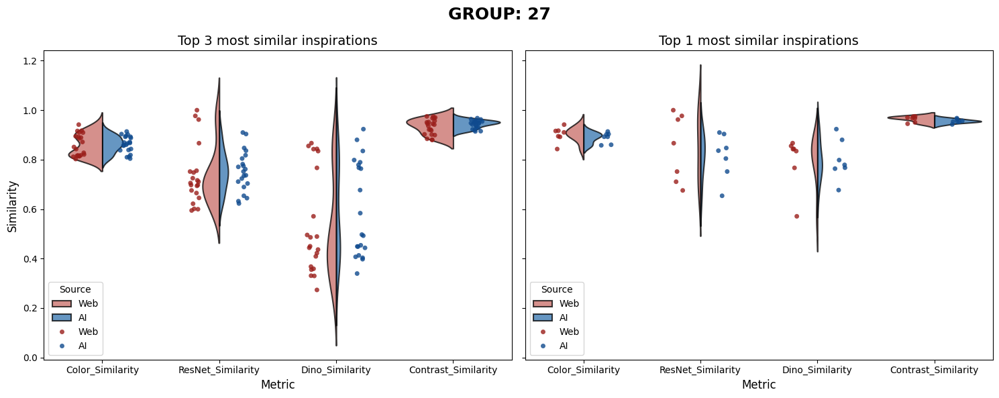

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
U-test top 3,none,none,none,none
U-test top 1,none,none,none,none
Mean_diff test,none,none,none,none
Decision of Weighted voting,Weakly Web,Strongly Web,Weakly AI,Strongly AI
Strength of Weighted voting,0.886372,1.391431,0.570615,3.807268


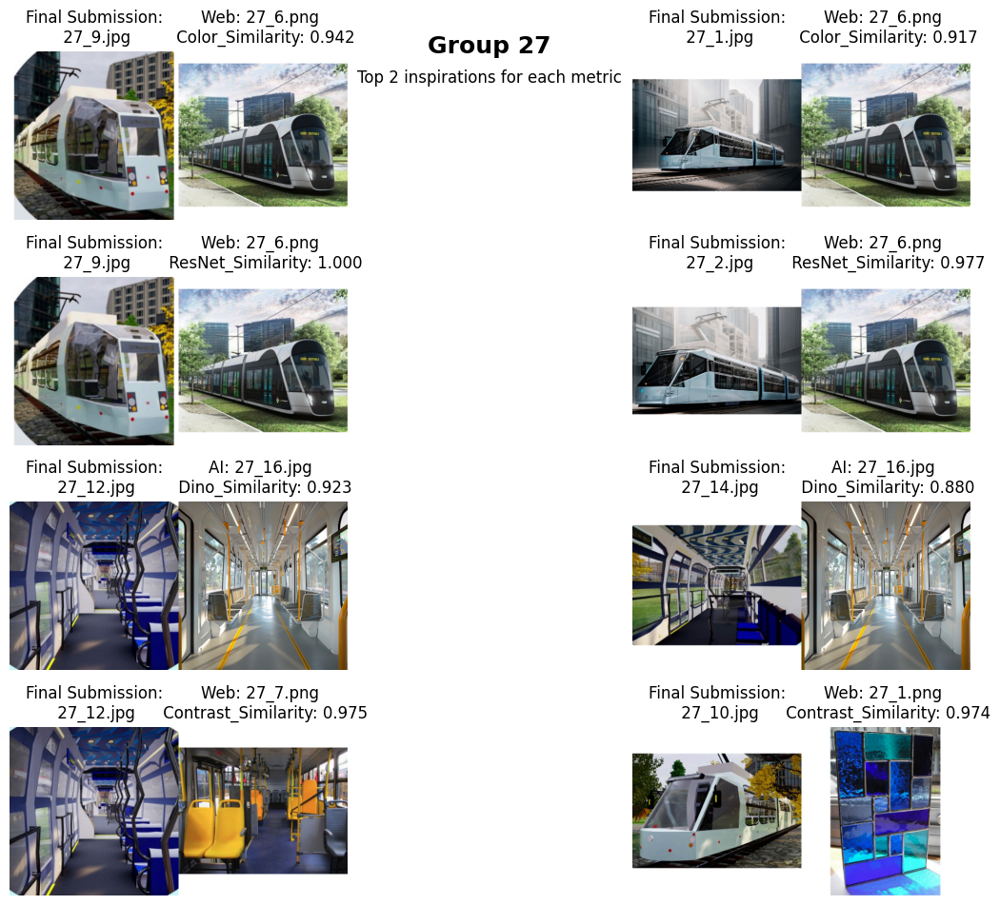

In [18]:
for i in range(1, 26):
    analyse_group(i)

analyse_group(27)

## Global analysis

In [48]:
def show_similarity_all_groups(top_count=5):

    metrics = ['Color_Similarity', 'ResNet_Similarity', 'Dino_Similarity', 'Contrast_Similarity']
    combined_df_melted = pd.melt(
            combined_df,
            id_vars=['Final_Submission', 'Source'],
            value_vars=metrics,
            var_name='Metric',
            value_name='Similarity'
        )

    combined_df_melted['Metric'] = pd.Categorical(combined_df_melted['Metric'], categories=metrics, ordered=True)

    top_similarities = (combined_df_melted
                        .sort_values(['Final_Submission', 'Metric', 'Source', 'Similarity'], ascending=[True, True, False, False])
                        .groupby(['Final_Submission', 'Metric', 'Source'], observed=True)
                        .head(top_count))

    custom_palette = {'AI': '#1E74C3', 'Web': '#D85C56'}   

    plt.figure(figsize=(10, 6))

    sns.violinplot(x="Metric", y="Similarity", hue="Source", data=top_similarities, 
                   inner=None, linewidth=1.5, split=True, palette=custom_palette, alpha=0.75,
                   edgecolor='black')  


    plt.suptitle(f'ALL GROUPS', fontsize=18, fontweight='bold')
    plt.title(f'Top {top_count} most similar inspirations', fontsize=14)
    plt.xlabel('Metric', fontsize=14, fontweight='bold')
    plt.ylabel('Similarity', fontsize=14, fontweight='bold')
    plt.tight_layout()  
    plt.show()
    
    return top_similarities


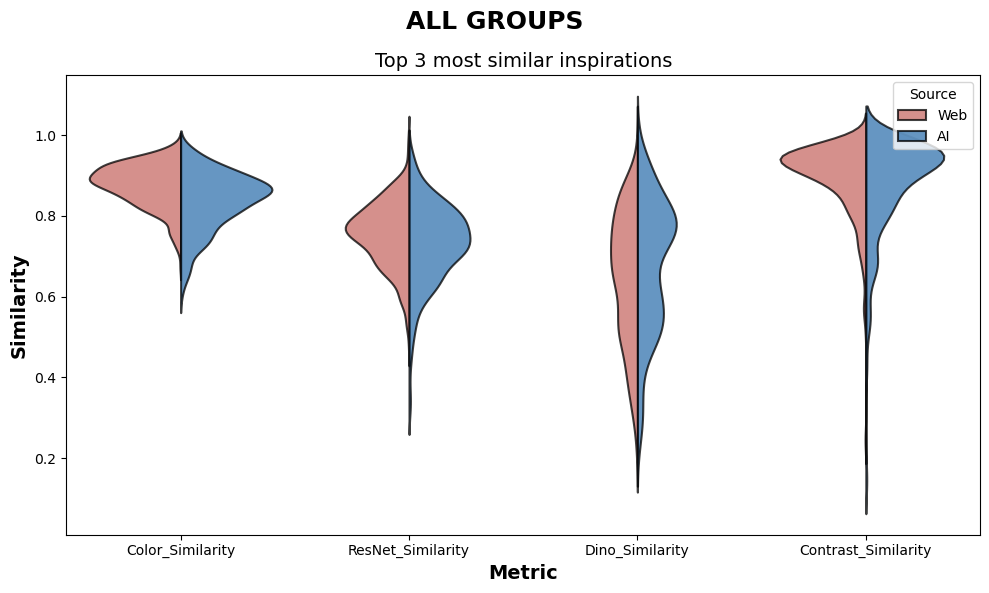

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
Conclusion_U_test,Web,Web,AI,none
Conclusion_Z_test,Web,Web,AI,Web
Conclusion_T_test,Web,Web,AI,Web
Conclusion_Wilcoxon,Web,Web,None,Web


In [49]:
data = show_similarity_all_groups(3)
u_results = perform_mannwhitneyu_test(data)
z_results = perform_z_test(data)
t_results = perform_t_test(data)
wilc_results = perform_wilcoxon_analysis(data)

results = pd.concat([u_results, z_results, t_results, wilc_results], axis=0)
results

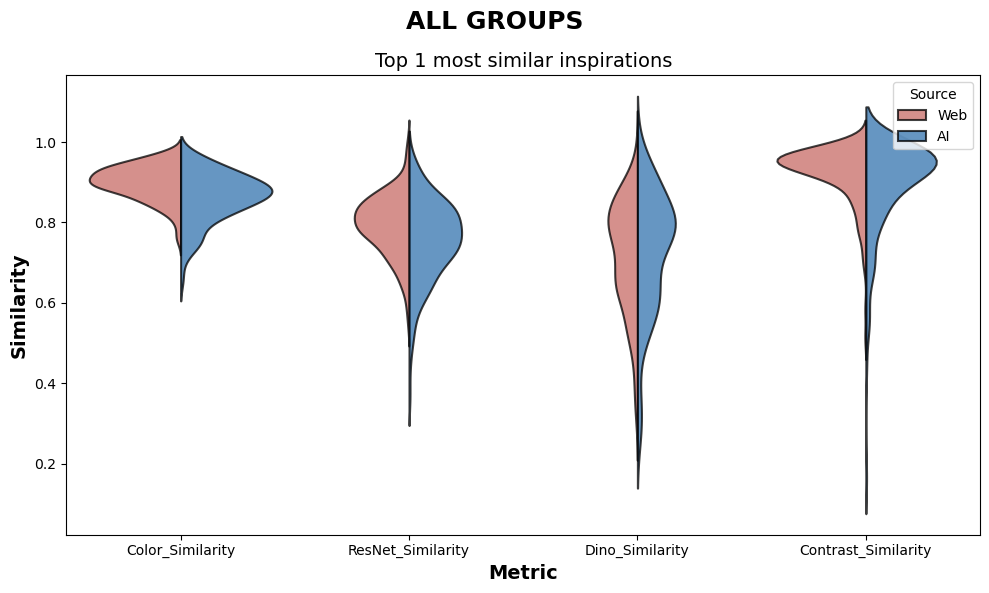

,Color_Similarity,ResNet_Similarity,Dino_Similarity,Contrast_Similarity
Conclusion_U_test,Web,Web,none,none
Conclusion_Z_test,Web,Web,none,Web
Conclusion_T_test,Web,Web,none,Web
Conclusion_Wilcoxon,Web,Web,None,Web


In [50]:
data = show_similarity_all_groups(1)
u_results = perform_mannwhitneyu_test(data)
z_results = perform_z_test(data)
t_results = perform_t_test(data)
wilc_results = perform_wilcoxon_analysis(data)

results = pd.concat([u_results, z_results, t_results, wilc_results], axis=0)
results

## Plots for presentation - absurdly visible

In [51]:
def show_similarity_all_groups_presentation(top_count=5):
    metrics = ['Color_Similarity', 'Contrast_Similarity', 'ResNet_Similarity', 'Dino_Similarity']
    metric_names = ['Color', 'Contrast', 'ResNet', 'Dino']

    metric_mapping = dict(zip(metrics, metric_names))

    combined_df_melted = pd.melt(
        combined_df,
        id_vars=['Final_Submission', 'Source'],
        value_vars=metrics,
        var_name='Metric',
        value_name='Similarity'
    )

    combined_df_melted['Metric'] = pd.Categorical(
        combined_df_melted['Metric'].map(metric_mapping),
        categories=metric_names,
        ordered=True
    )

    top_similarities = (combined_df_melted
                        .sort_values(['Final_Submission', 'Metric', 'Source', 'Similarity'], ascending=[True, True, False, False])
                        .groupby(['Final_Submission', 'Metric', 'Source'], observed=True)
                        .head(top_count))

    custom_palette = {'AI': '#1E74C3', 'Web': '#D85C56'}

    plt.figure(figsize=(10, 6))

    sns.violinplot(
        x="Metric",
        y="Similarity",
        hue="Source",
        data=top_similarities,
        inner=None,
        linewidth=1.5,
        split=True,
        palette=custom_palette,
        alpha=0.75
    )

    plt.title(f'Distribution of top {top_count} most similar inspirations for all groups', fontsize=20, fontweight='bold')

    plt.xlabel('Metric', fontsize=18, fontweight='bold')
    plt.ylabel('Similarity', fontsize=18, fontweight='bold')

    plt.tick_params(axis='x', labelsize=16)
    plt.tick_params(axis='y', labelsize=16)

    plt.legend(title='Source', loc='lower left', fontsize=12, title_fontsize=18)
    plt.tight_layout()
    plt.show()

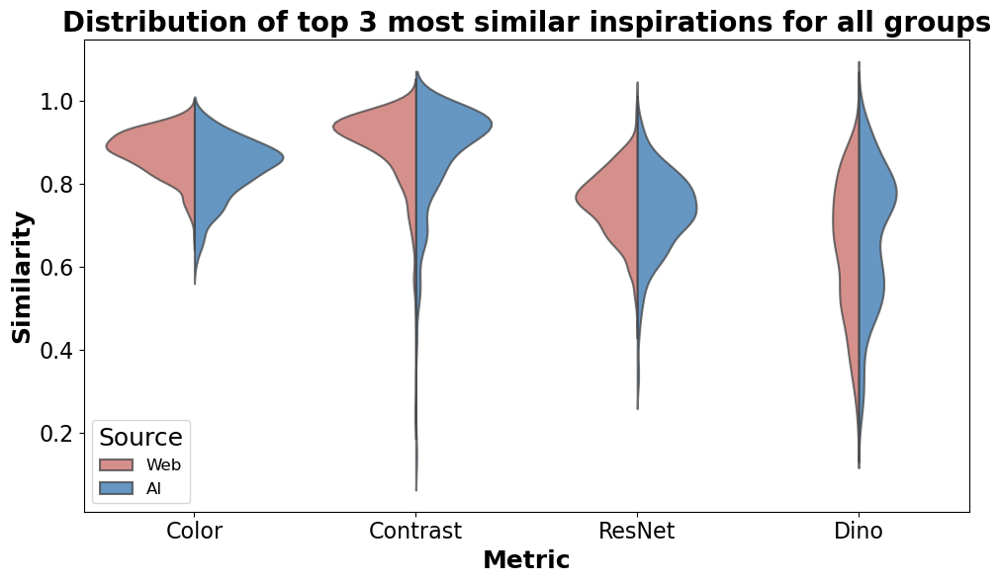

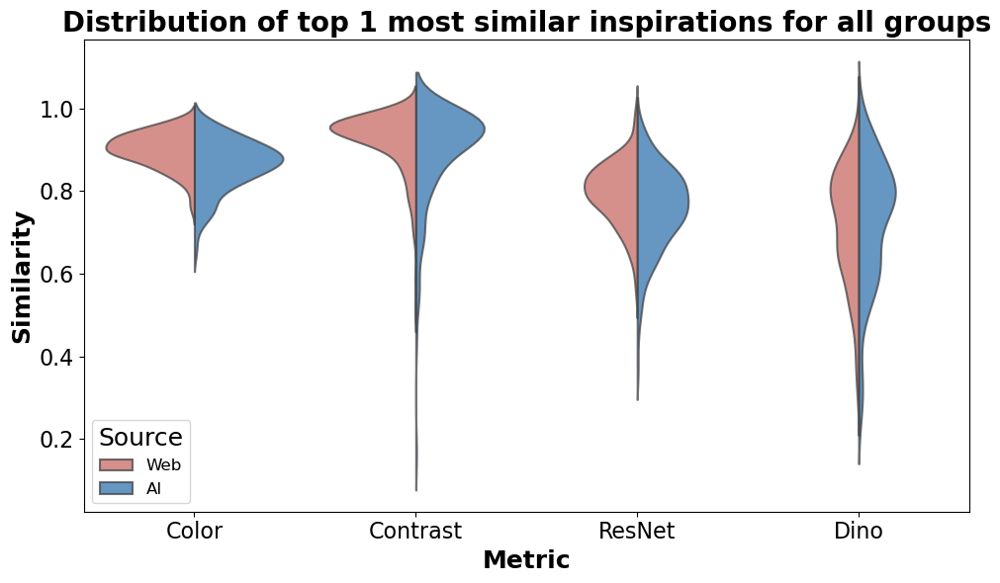

In [52]:
show_similarity_all_groups_presentation(3)
show_similarity_all_groups_presentation(1)